In [1]:
import cv2
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
from skimage.morphology import remove_small_holes,remove_small_objects,binary_closing,closing,convex_hull_image
from skimage.morphology import skeletonize, thin
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler,OneHotEncoder,MultiLabelBinarizer
from sklearn.neighbors import KNeighborsClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier,GradientBoostingClassifier
from xgboost import XGBClassifier
from sklearn.tree import DecisionTreeClassifier,plot_tree
from sklearn.metrics import confusion_matrix,roc_auc_score,f1_score,classification_report
from scipy import stats
from imblearn.over_sampling import SMOTE 
import pandas as pd
import seaborn as sns
import os
from collections import Counter

In [2]:
# Function definition of image segmentation to separate the potential bacilli objects from image background

def image_segmentation(img):
    
    img_ycrcb = cv2.cvtColor(img, cv2.COLOR_BGR2YCrCb)
    img_cr = img_ycrcb[:,:,1]       
    cr_hist,_ = np.histogram(img_cr.ravel(),256,[0,256])
    cr_hist_diff = np.diff(cr_hist)

    img_lab = cv2.cvtColor(img, cv2.COLOR_BGR2LAB)
    img_a = img_lab[:,:,1]
    a_hist,_ = np.histogram(img_a.ravel(),256,[0,256])
    a_hist_diff = np.diff(a_hist)
    
    int_lvls = np.arange(0,255)
    
    cr_hist_th = int(-18000*(orig_img_shape[0]*orig_img_shape[1])/(1200*900))
    if (int_lvls[cr_hist_diff<=cr_hist_th].size!=0):
        cr_th_i = np.max(int_lvls[cr_hist_diff<=cr_hist_th])
    else:
        cr_th_i = np.argmax(cr_hist)

    a_hist_th = int(-1000*(orig_img_shape[0]*orig_img_shape[1])/(1200*900))
    if (int_lvls[a_hist_diff<=a_hist_th].size!=0):
        a_th_i = np.max(int_lvls[a_hist_diff<=a_hist_th])
    else:
        a_th_i = np.argmax(a_hist)

    
    a_th = a_th_i
    cr_th = cr_th_i
    _, img_a_th = cv2.threshold(img_a, a_th, 255, cv2.THRESH_BINARY)
    _, img_cr_th = cv2.threshold(img_cr, cr_th, 255, cv2.THRESH_BINARY)
    
    img_seg = cv2.bitwise_and(img_cr_th,img_a_th)

    return img_seg

In [3]:
# Function definition of image postprocessing to remove small size artifacts from segmented image

def image_postprocess(img_seg):
    
    # Removing small size artifacts on segmented image
    img_bin1 = (img_seg//255).astype(bool)
    img_rem1 = remove_small_objects(img_bin1,min_size=20,connectivity=8).astype('uint8')*255
    #img_fill = (remove_small_holes(img_rem1,area_threshold=5000,connectivity=8)).astype('uint8')*255
    #img_bin2 = (img_fill//255).astype(bool)
    #img_rem2 = remove_small_objects(img_bin2,min_size=50,connectivity=8).astype('uint8')*255
    img_pp = img_rem1.copy()
    
    return img_pp

In [4]:
# Function definition to assign class label to each image object

def label_image_objects(img_file,annot_fold_path):

    annot_file = img_file[:-4]+'_annot.csv'
    annot_file_path = os.path.join(annot_fold_path,annot_file)

    annot_cols = ["Label","x_st_pt","y_st_pt","box_width","box_height","Image_name","Image_width","Image_height"]

    lbl_data = pd.read_csv(annot_file_path,names=annot_cols, header=0)
    
    img_lbl = np.ones(orig_img_shape[:2], np.uint8)*20

    for i in range(lbl_data.shape[0]):
        x_st_pt = lbl_data["x_st_pt"][i]
        y_st_pt = lbl_data["y_st_pt"][i]
        x_end_pt = x_st_pt+lbl_data["box_width"][i]
        y_end_pt = y_st_pt+lbl_data["box_height"][i]
        if (lbl_data["Label"][i]=="single bacillus"):
            fill_val = 50
        if (lbl_data["Label"][i]=="bacilli cluster"):
            fill_val = 100
        if (lbl_data["Label"][i]=="unclassified red structures"):
            fill_val = 150
        if (lbl_data["Label"][i]=="artifacts"):
            fill_val = 200
        st_pt = (x_st_pt,y_st_pt)
        end_pt = (x_end_pt,y_end_pt)
        cv2.rectangle(img_lbl, st_pt, end_pt, fill_val, thickness=-1)
    
    img_lbl = cv2.resize(img_lbl,(img_shape[1],img_shape[0]))

    img_pp_lbl = cv2.bitwise_and(img_pp,img_lbl)
    
    return img_lbl,img_pp_lbl

In [5]:
# Function definition to get class label of the contour based on pixel intensity

def get_class_lbl(img_lbl,cnt_centre):
    if (img_lbl[cnt_centre[1],cnt_centre[0]]==50):
        cls_lbl = "1"
    elif (img_lbl[cnt_centre[1],cnt_centre[0]]==100):
        cls_lbl = "2"
    elif (img_lbl[cnt_centre[1],cnt_centre[0]]==200):
        cls_lbl = "3"
    else:
        cls_lbl = None
    
    return cls_lbl

In [6]:
def count_single_bacillus(cnt):
    sing_tb_count = 0
    cnt_approx = cv2.approxPolyDP(cnt,0.005*cv2.arcLength(cnt, True),True)
    hull = cv2.convexHull(cnt_approx, returnPoints=False)
    hull[::-1].sort(axis=0)
    defects = cv2.convexityDefects(cnt_approx, hull)
    if (defects is not None and defects.shape[0]>1):
        st_ind = -1
        #st_ind = 0
        for j in range(st_ind,defects.shape[0]-1):
            ind1 = defects[j,0,2]
            ind2 = defects[j+1,0,2]
            #print(ind1,ind2)
            if (ind1>ind2):
                list1 = list(range(ind1,cnt_approx.shape[0]))
                list2 = list(range(0,ind2+1))
                list_ = list1+list2
                #print(list_)
                cnt_temp1 = cnt_approx[list_]
            else:
                cnt_temp1 = cnt_approx[ind1:ind2+1]
            #print(cnt_temp1)
            img_temp = np.zeros(img_shape, np.uint8)
            img_temp = cv2.drawContours(img_temp, [cnt_temp1], -1, 255, 3)
            contours_temp,_ = cv2.findContours(img_temp, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
            cnt_temp2 = contours_temp[0]
            
            if (len(cnt_temp2)>=5):
                (x,y),(ma,MA),angle = cv2.fitEllipse(cnt_temp2)
                eccentricity = ma/MA
                area = cv2.contourArea(cnt_temp2)
                #print((eccentricity,area))
                if (eccentricity>0.1 and eccentricity<0.7 and area>50):
                    sing_tb_count+=1
                    
    return sing_tb_count,defects    

In [7]:
import cv2
import pandas as pd
import os

def detect_and_save_bounding_boxes(image, image_name, output_dir):
    # Convert image to grayscale (if not already)
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    
    # Threshold the image to get binary image of white objects
    _, binary = cv2.threshold(gray, 200, 255, cv2.THRESH_BINARY)
    
    # Find contours
    contours, _ = cv2.findContours(binary, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    # Prepare data for CSV
    data = []
    image_height, image_width = image.shape[:2]
    
    for contour in contours:
        x, y, w, h = cv2.boundingRect(contour)
        data.append({
            'x_st_pt': x,
            'y_st_pt': y,
            'box_width': w,
            'box_height': h,
            'Image_name': image_name,
            'Image_width': image_width,
            'Image_height': image_height
        })
    
    # Create DataFrame
    df = pd.DataFrame(data)
    
    # Save to CSV
    csv_path = os.path.join(output_dir, f"{os.path.splitext(image_name)[0]}.csv")
    df.to_csv(csv_path, index=False)
    print(f"Saved bounding box information to {csv_path}")

In [8]:
import cv2
import os
import pandas as pd

img_shape = (600, 800)

def detect_and_save_bounding_boxes(image, image_name, output_dir):
    # Check if the image has 3 channels
    if len(image.shape) == 2:  # Grayscale image
        print("Warning: Image is grayscale. Converting to BGR.")
        image = cv2.cvtColor(image, cv2.COLOR_GRAY2BGR)
    
    if len(image.shape) != 3 or image.shape[2] != 3:
        print("Error: Unexpected number of channels in the image.")
        return
    
    # Convert image to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    
    # Threshold the image to get binary image of white objects
    _, binary = cv2.threshold(gray, 200, 255, cv2.THRESH_BINARY)
    
    # Find contours
    contours, _ = cv2.findContours(binary, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    # Prepare data for CSV
    data = []
    image_height, image_width = image.shape[:2]
    
    for contour in contours:
        x, y, w, h = cv2.boundingRect(contour)
        data.append({
            'x_st_pt': x,
            'y_st_pt': y,
            'box_width': w,
            'box_height': h,
            'Image_name': image_name,
            'Image_width': image_width,
            'Image_height': image_height
        })
    
    # Create DataFrame
    df = pd.DataFrame(data)
    
    # Save to CSV
    csv_path = os.path.join(output_dir, f"{os.path.splitext(image_name)[0]}.csv")
    df.to_csv(csv_path, index=False)
    print(f"Saved bounding box information to {csv_path}")

# Training Part

In [9]:
# Main Folder consisting of image data
main_fold = r"C:\Users\JEEVANANTHAM\Downloads\bacilli_count\code\baci-count\data\train-test"

# Image subfolders
# folders = ["Mannual_Microscope-2_set1","Mannual_Microscope-2_set2","Mannual_Seg_Microscope-1_set6","Mannual_Seg_Microscope-1_set7"]

folders = ["Mannual_Microscope-2_set1"]

In [10]:
data_list = []

for folder in folders:
    fold_path = os.path.join(main_fold, folder)
    img_fold_path = os.path.join(fold_path, "Images")
    annot_fold_path = os.path.join(fold_path, "Annotations")
    img_files = os.listdir(img_fold_path)

    for img_file in img_files:
        img_file_path = os.path.join(img_fold_path, img_file)
        orig_img = cv2.imread(img_file_path)

        if orig_img is None:
            print(f"Warning: Unable to read image {img_file_path}")
            continue

        orig_img_shape = orig_img.shape[0:2]
        img = orig_img.copy()

        img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
        _, img_th = cv2.threshold(img_gray, 30, 255, cv2.THRESH_BINARY_INV)
        img_th_inv = 255 - img_th
        
        img_seg = image_segmentation(img)
        img_seg = cv2.bitwise_and(img_seg, img_th_inv)
        img_seg = cv2.resize(img_seg, (img_shape[1], img_shape[0]))

        img_pp = image_postprocess(img_seg)
        
        # Detect and save bounding boxes for the post-processed image
        output_dir = 'data/train-test/Mannual_Microscope-2_set1/autoAnnotate'
        detect_and_save_bounding_boxes(img_pp, img_file, output_dir)

Saved bounding box information to data/train-test/Mannual_Microscope-2_set1/autoAnnotate\1.csv
Saved bounding box information to data/train-test/Mannual_Microscope-2_set1/autoAnnotate\10.csv
Saved bounding box information to data/train-test/Mannual_Microscope-2_set1/autoAnnotate\11.csv
Saved bounding box information to data/train-test/Mannual_Microscope-2_set1/autoAnnotate\12.csv
Saved bounding box information to data/train-test/Mannual_Microscope-2_set1/autoAnnotate\13.csv
Saved bounding box information to data/train-test/Mannual_Microscope-2_set1/autoAnnotate\14.csv
Saved bounding box information to data/train-test/Mannual_Microscope-2_set1/autoAnnotate\15.csv
Saved bounding box information to data/train-test/Mannual_Microscope-2_set1/autoAnnotate\16.csv
Saved bounding box information to data/train-test/Mannual_Microscope-2_set1/autoAnnotate\17.csv
Saved bounding box information to data/train-test/Mannual_Microscope-2_set1/autoAnnotate\18.csv
Saved bounding box information to data/tr

In [11]:
import os
import pandas as pd

def extract_and_save_bounding_box_images(image_dir, csv_dir, output_dir):
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)

    # Iterate through each CSV file in the csv_dir
    for csv_file in os.listdir(csv_dir):
        if not csv_file.endswith('.csv'):
            continue

        # Load CSV file with bounding box information
        csv_path = os.path.join(csv_dir, csv_file)
        df = pd.read_csv(csv_path)

        # Check if DataFrame is empty or missing required columns
        if df.empty:
            print(f"Warning: {csv_file} is empty.")
            continue
        if 'Image_name' not in df.columns:
            print(f"Warning: 'Image_name' column not found in {csv_file}.")
            continue

        # Extract the image name from the CSV
        image_name = df['Image_name'].iloc[0]
        image_path = os.path.join(image_dir, image_name)

        # Load the original image
        image = cv2.imread(image_path)
        if image is None:
            print(f"Warning: Unable to read image {image_path}")
            continue

        # Process bounding boxes
        for idx, row in df.iterrows():
            x, y, w, h = row['x_st_pt'], row['y_st_pt'], row['box_width'], row['box_height']
            label = row['Label']

            # Extract the bounding box from the image
            bbox_image = image[int(y):int(y+h), int(x):int(x+w)]

            # Create a directory for the label if it doesn't exist
            label_dir = os.path.join(output_dir, label)
            if not os.path.exists(label_dir):
                os.makedirs(label_dir)

            # Save the cropped bounding box as an image
            bbox_image_path = os.path.join(label_dir, f"{os.path.splitext(image_name)[0]}_bbox_{idx}.jpg")
            cv2.imwrite(bbox_image_path, bbox_image)
            print(f"Saved: {bbox_image_path}")

# Specify directories
image_dir = 'data/train-test/Mannual_Microscope-2_set1/Images'
csv_dir = 'data/train-test/Mannual_Microscope-2_set1/Annotations'
output_dir = 'data/train-test/Mannual_Microscope-2_set1/BoundingBoxImages'

# Extract and save bounding box images
extract_and_save_bounding_box_images(image_dir, csv_dir, output_dir)


Saved: data/train-test/Mannual_Microscope-2_set1/BoundingBoxImages\unclassified red structures\11_bbox_0.jpg
Saved: data/train-test/Mannual_Microscope-2_set1/BoundingBoxImages\artifacts\11_bbox_1.jpg
Saved: data/train-test/Mannual_Microscope-2_set1/BoundingBoxImages\artifacts\12_bbox_0.jpg
Saved: data/train-test/Mannual_Microscope-2_set1/BoundingBoxImages\artifacts\12_bbox_1.jpg
Saved: data/train-test/Mannual_Microscope-2_set1/BoundingBoxImages\unclassified red structures\13_bbox_0.jpg
Saved: data/train-test/Mannual_Microscope-2_set1/BoundingBoxImages\single bacillus\13_bbox_1.jpg
Saved: data/train-test/Mannual_Microscope-2_set1/BoundingBoxImages\artifacts\13_bbox_2.jpg
Saved: data/train-test/Mannual_Microscope-2_set1/BoundingBoxImages\single bacillus\13_bbox_3.jpg
Saved: data/train-test/Mannual_Microscope-2_set1/BoundingBoxImages\single bacillus\13_bbox_4.jpg
Saved: data/train-test/Mannual_Microscope-2_set1/BoundingBoxImages\artifacts\13_bbox_5.jpg
Saved: data/train-test/Mannual_Micro

In [12]:
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras import layers, models

# Define the CNN model
def create_cnn_model(input_shape, num_classes):
    model = models.Sequential([
        layers.Conv2D(32, (3, 3), activation='relu', input_shape=input_shape),
        layers.MaxPooling2D((2, 2)),
        layers.Conv2D(64, (3, 3), activation='relu'),
        layers.MaxPooling2D((2, 2)),
        layers.Conv2D(128, (3, 3), activation='relu'),
        layers.MaxPooling2D((2, 2)),
        layers.Flatten(),
        layers.Dense(128, activation='relu'),
        layers.Dense(num_classes, activation='softmax')
    ])
    
    model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])
    return model

# Data preprocessing using ImageDataGenerator
train_datagen = ImageDataGenerator(rescale=1./255, validation_split=0.2)

# Load training data from the bounding box image directory
train_generator = train_datagen.flow_from_directory(
    'data/train-test/Mannual_Microscope-2_set1/BoundingBoxImages',
    target_size=(64, 64),  # Resize all images to 64x64
    batch_size=32,
    class_mode='sparse',
    subset='training')

validation_generator = train_datagen.flow_from_directory(
    'data/train-test/Mannual_Microscope-2_set1/BoundingBoxImages',
    target_size=(64, 64),
    batch_size=32,
    class_mode='sparse',
    subset='validation')

# Create CNN model
input_shape = (64, 64, 3)  # Change input shape if needed
num_classes = len(train_generator.class_indices)  # Number of classes based on directory structure
model = create_cnn_model(input_shape, num_classes)

# Train the model
model.fit(train_generator, epochs=10, validation_data=validation_generator)


Found 122 images belonging to 4 classes.
Found 29 images belonging to 4 classes.



Epoch 1/10


4/4 [==============================] - 2s 191ms/step - loss: 1.2244 - accuracy: 0.4590 - val_loss: 1.0456 - val_accuracy: 0.6207
Epoch 2/10
4/4 [==============================] - 0s 49ms/step - loss: 1.0796 - accuracy: 0.5902 - val_loss: 1.0333 - val_accuracy: 0.6207
Epoch 3/10
4/4 [==============================] - 0s 50ms/step - loss: 0.9997 - accuracy: 0.5902 - val_loss: 0.9107 - val_accuracy: 0.6207
Epoch 4/10
4/4 [==============================] - 0s 71ms/step - loss: 0.8358 - accuracy: 0.6393 - val_loss: 0.7297 - val_accuracy: 0.6897
Epoch 5/10
4/4 [==============================] - 0s 48ms/step - loss: 0.6399 - accuracy: 0.7213 - val_loss: 0.5684 - val_accuracy: 0.8966
Epoch 6/10
4/4 [==============================] - 0s 50ms/step - loss: 0.4739 - accuracy: 0.8279 - val_loss: 0.3769 - val_accuracy: 0.7586
Epoch 7/10
4/4 [==============================] - 0s 60ms/step - loss: 0.3662 

In [13]:
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping
import matplotlib.pyplot as plt

# Define callbacks
checkpoint = ModelCheckpoint('best_model.h5', monitor='val_loss', save_best_only=True, mode='min', verbose=1)
early_stopping = EarlyStopping(monitor='val_loss', patience=3, mode='min', verbose=1)

# Train the model with callbacks
history = model.fit(
    train_generator,
    epochs=10,
    validation_data=validation_generator,
    callbacks=[checkpoint, early_stopping]
)


Epoch 1/10
3/4 [=====================>........] - ETA: 0s - loss: 0.0713 - accuracy: 0.9792
Epoch 1: val_loss improved from inf to 0.09907, saving model to best_model.h5
4/4 [==============================] - 0s 73ms/step - loss: 0.0585 - accuracy: 0.9836 - val_loss: 0.0991 - val_accuracy: 0.9655
Epoch 2/10
3/4 [=====================>........] - ETA: 0s - loss: 0.0244 - accuracy: 1.0000

c:\Python311\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(



Epoch 2: val_loss improved from 0.09907 to 0.09777, saving model to best_model.h5
4/4 [==============================] - 0s 62ms/step - loss: 0.0424 - accuracy: 0.9918 - val_loss: 0.0978 - val_accuracy: 0.9310
Epoch 3/10
3/4 [=====================>........] - ETA: 0s - loss: 0.0385 - accuracy: 0.9889
Epoch 3: val_loss improved from 0.09777 to 0.03194, saving model to best_model.h5
4/4 [==============================] - 0s 69ms/step - loss: 0.0331 - accuracy: 0.9918 - val_loss: 0.0319 - val_accuracy: 1.0000
Epoch 4/10
3/4 [=====================>........] - ETA: 0s - loss: 0.0298 - accuracy: 0.9889
Epoch 4: val_loss improved from 0.03194 to 0.00580, saving model to best_model.h5
4/4 [==============================] - 0s 73ms/step - loss: 0.0239 - accuracy: 0.9918 - val_loss: 0.0058 - val_accuracy: 1.0000
Epoch 5/10
3/4 [=====================>........] - ETA: 0s - loss: 0.0254 - accuracy: 0.9896
Epoch 5: val_loss improved from 0.00580 to 0.00500, saving model to best_model.h5
4/4 [======

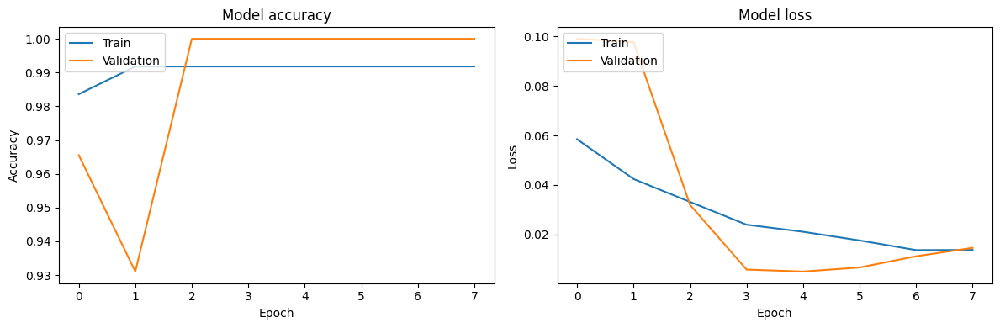

In [14]:
# Plot training & validation accuracy values
plt.figure(figsize=(12, 4))

plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend(['Train', 'Validation'], loc='upper left')

# Plot training & validation loss values
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(['Train', 'Validation'], loc='upper left')

plt.tight_layout()
plt.show()

In [69]:
# import cv2
# import os
# import pandas as pd

# img_shape = (600, 800)

# data_list = []

# for folder in folders:
#     fold_path = os.path.join(main_fold, folder)
#     img_fold_path = os.path.join(fold_path, "Images")
#     annot_fold_path = os.path.join(fold_path, "Annotations")
#     img_files = os.listdir(img_fold_path)

#     for img_file in img_files:
#         img_file_path = os.path.join(img_fold_path, img_file)
#         orig_img = cv2.imread(img_file_path)

#         if orig_img is None:
#             print(f"Warning: Unable to read image {img_file_path}")
#             continue

#         orig_img_shape = orig_img.shape[0:2]
#         img = orig_img.copy()

#         img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
#         _, img_th = cv2.threshold(img_gray, 30, 255, cv2.THRESH_BINARY_INV)
#         img_th_inv = 255 - img_th
        
#         img_seg = image_segmentation(img)
        
#         img_seg = cv2.bitwise_and(img_seg, img_th_inv)
        
#         img_seg = cv2.resize(img_seg, (img_shape[1], img_shape[0]))

#         img_pp = image_postprocess(img_seg)
        
#         img_lbl, img_pp_lbl = label_image_objects(img_file, annot_fold_path)   

#         output_dir = 'data/train-test/Mannual_Microscope-2_set1/autoAnnotate'

#         detect_and_save_bounding_boxes(img_pp, img_file, output_dir)

posx and posy should be finite values
posx and posy should be finite values


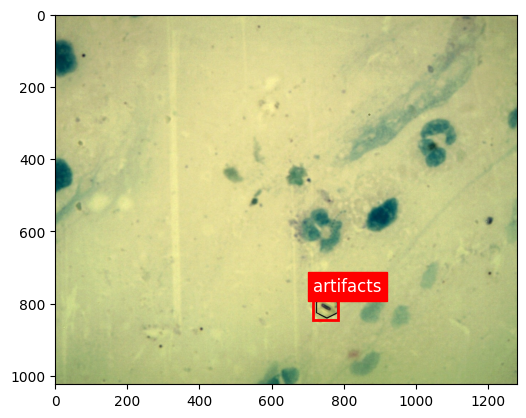

posx and posy should be finite values
posx and posy should be finite values


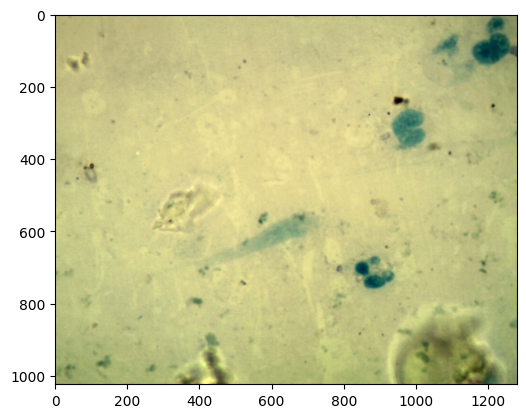

posx and posy should be finite values
posx and posy should be finite values


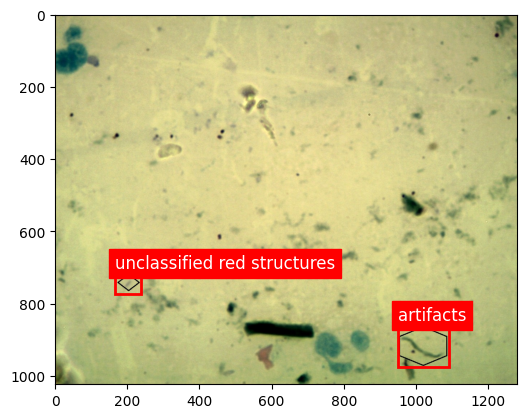

posx and posy should be finite values
posx and posy should be finite values


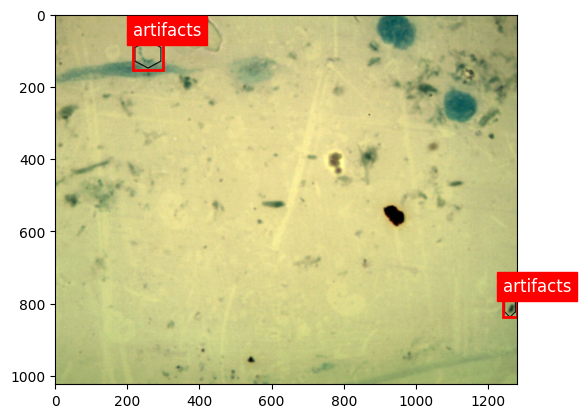

posx and posy should be finite values
posx and posy should be finite values


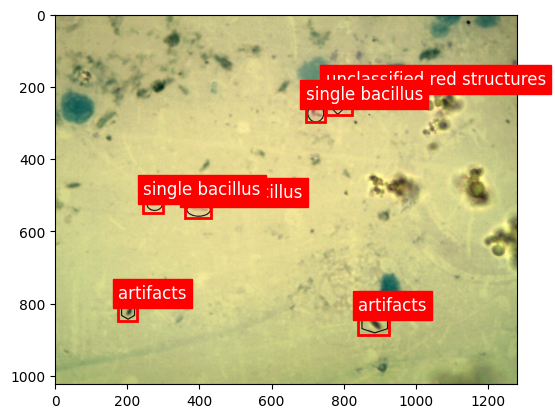

posx and posy should be finite values
posx and posy should be finite values


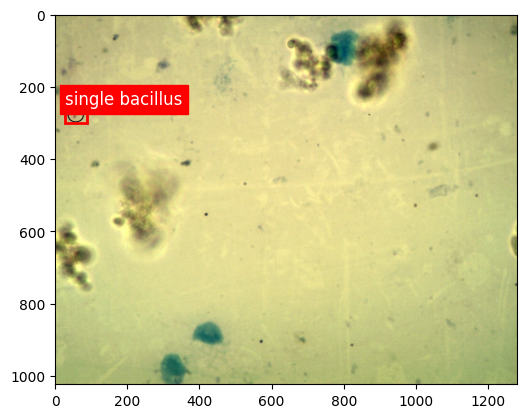

posx and posy should be finite values
posx and posy should be finite values


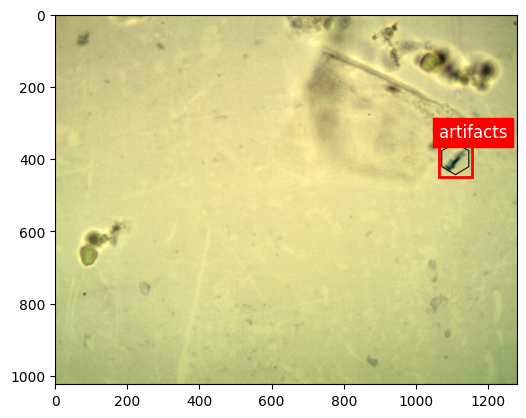

posx and posy should be finite values
posx and posy should be finite values


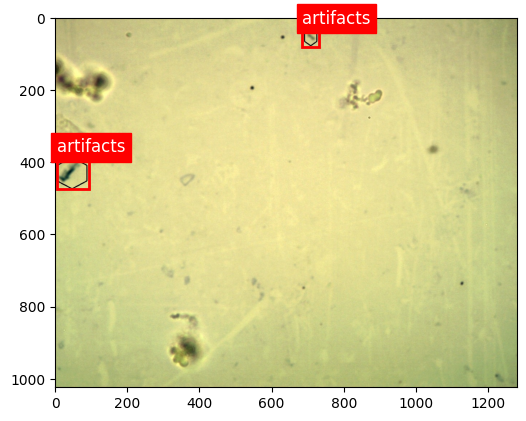

posx and posy should be finite values
posx and posy should be finite values


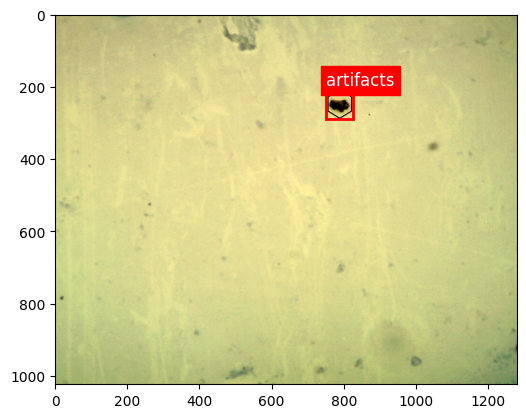

posx and posy should be finite values
posx and posy should be finite values


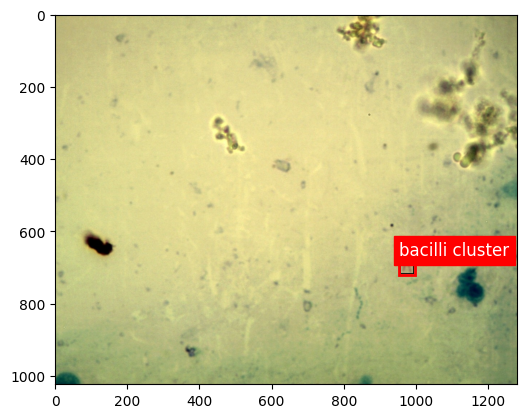

posx and posy should be finite values
posx and posy should be finite values


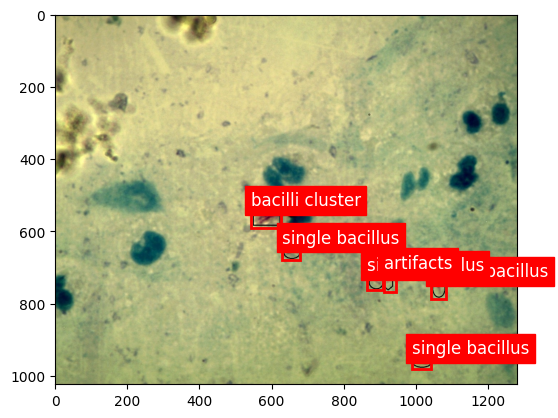

posx and posy should be finite values
posx and posy should be finite values


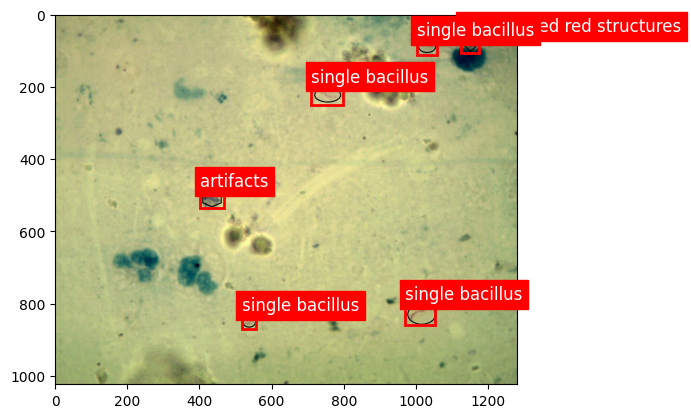

posx and posy should be finite values
posx and posy should be finite values


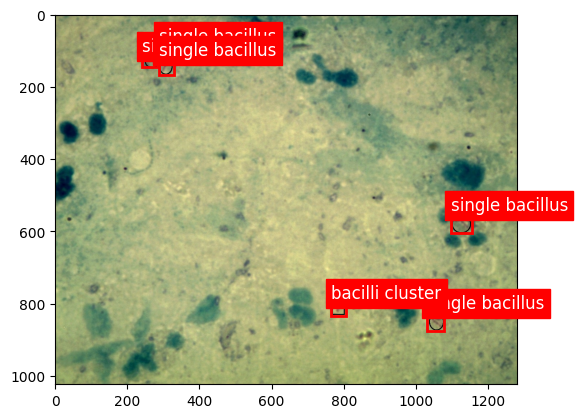

posx and posy should be finite values
posx and posy should be finite values


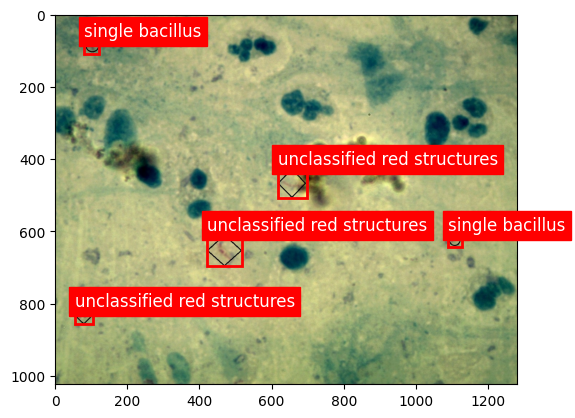

posx and posy should be finite values
posx and posy should be finite values


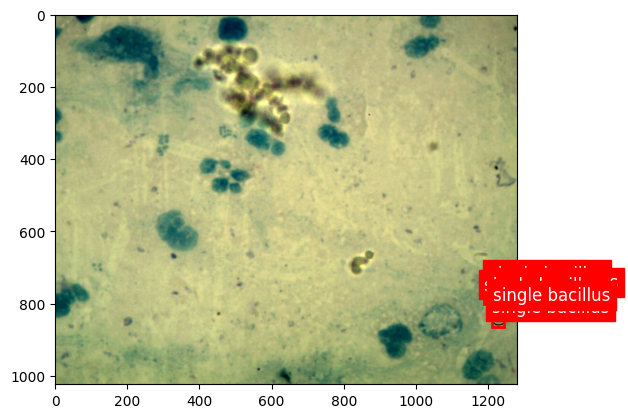

posx and posy should be finite values
posx and posy should be finite values


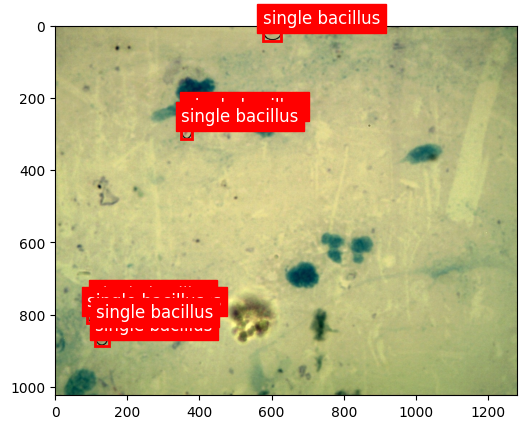

posx and posy should be finite values
posx and posy should be finite values


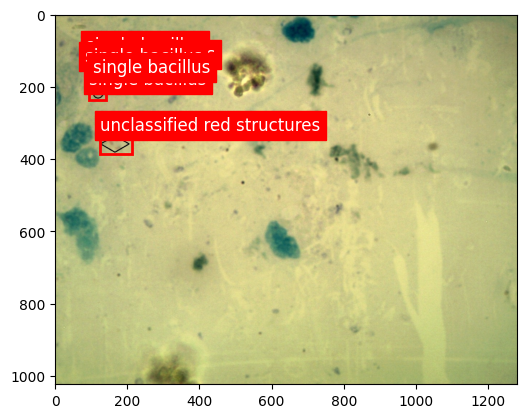

posx and posy should be finite values
posx and posy should be finite values


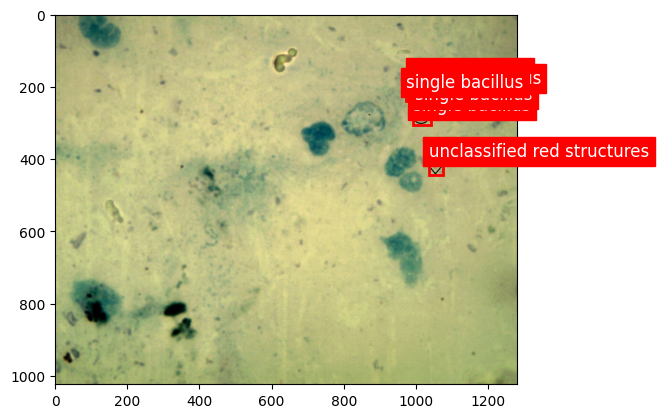

posx and posy should be finite values
posx and posy should be finite values


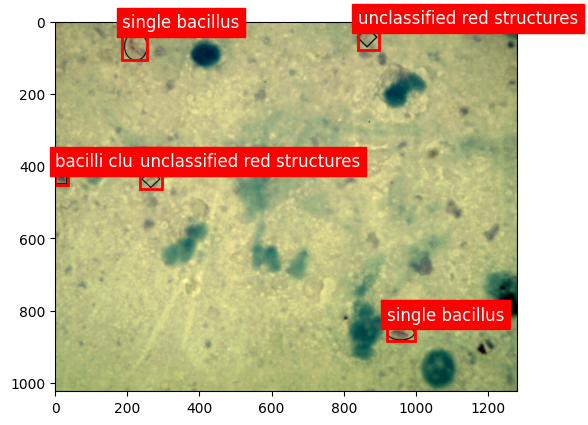

posx and posy should be finite values
posx and posy should be finite values


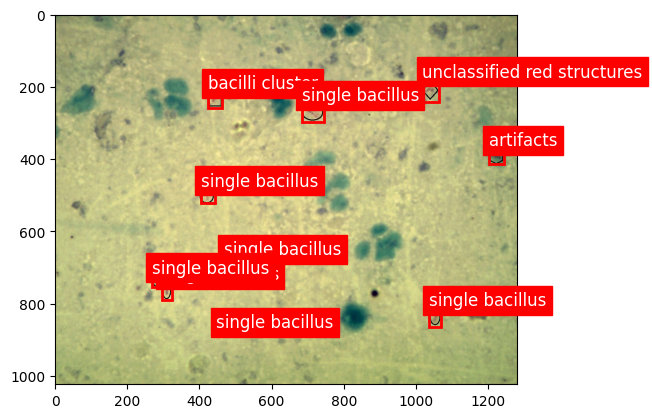

posx and posy should be finite values
posx and posy should be finite values


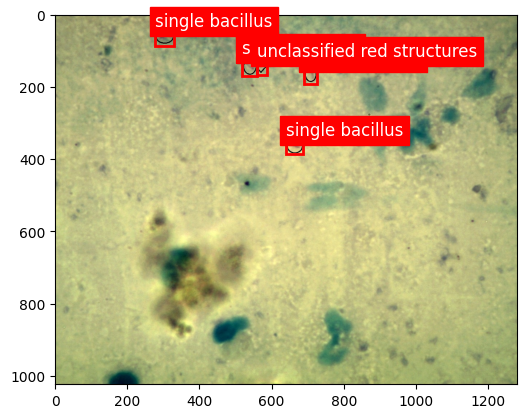

posx and posy should be finite values
posx and posy should be finite values


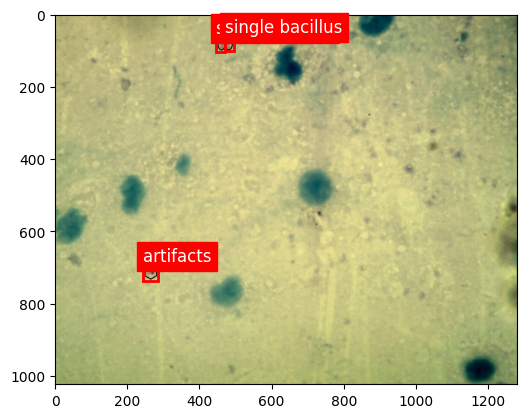

posx and posy should be finite values
posx and posy should be finite values


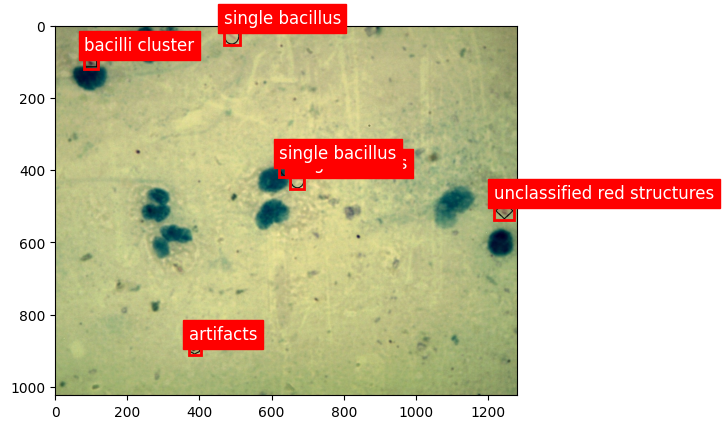

posx and posy should be finite values
posx and posy should be finite values


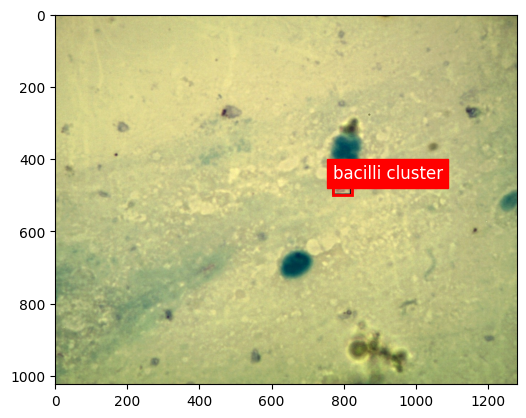

posx and posy should be finite values
posx and posy should be finite values


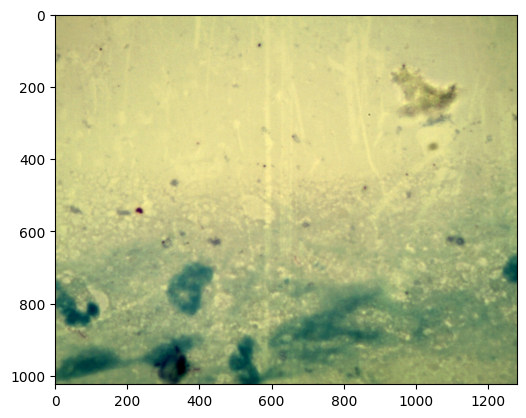

posx and posy should be finite values
posx and posy should be finite values


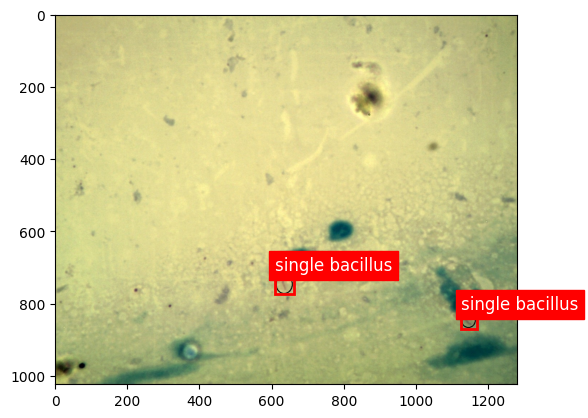

posx and posy should be finite values
posx and posy should be finite values


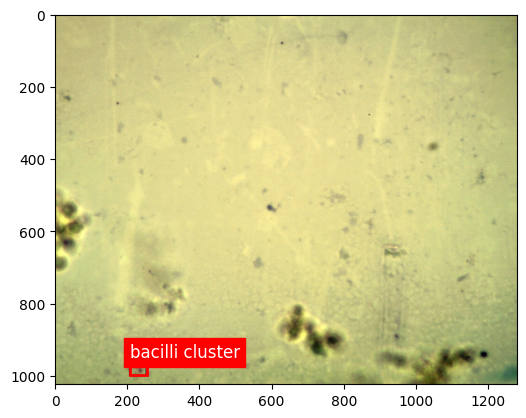

posx and posy should be finite values
posx and posy should be finite values


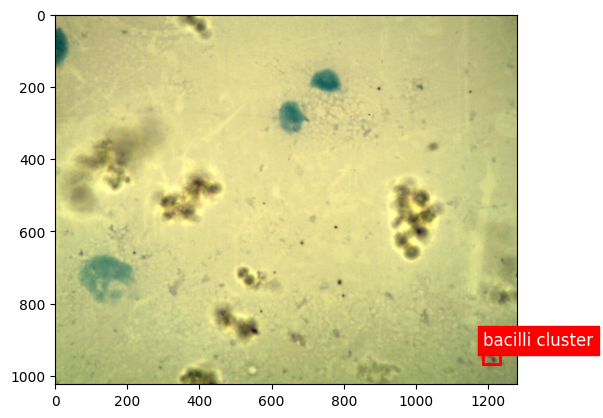

posx and posy should be finite values
posx and posy should be finite values


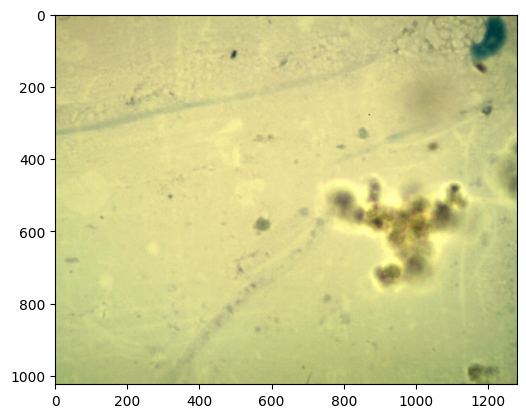

posx and posy should be finite values
posx and posy should be finite values


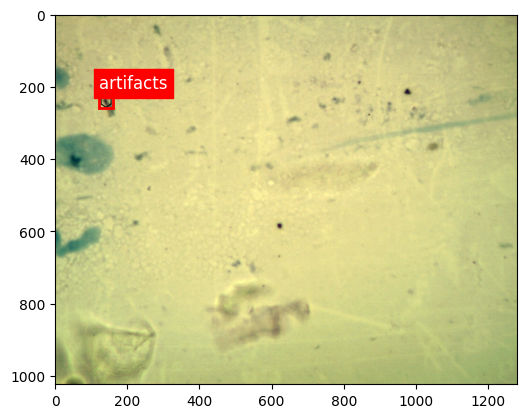

posx and posy should be finite values
posx and posy should be finite values


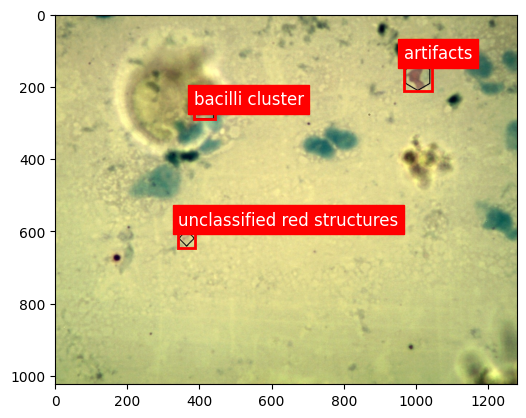

posx and posy should be finite values
posx and posy should be finite values


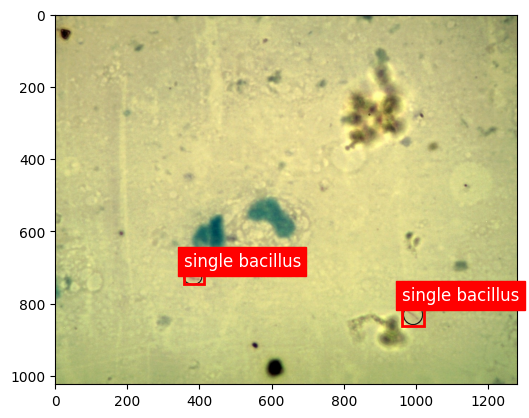

posx and posy should be finite values
posx and posy should be finite values


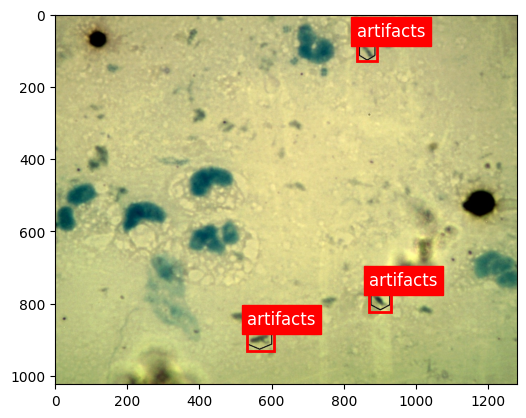

posx and posy should be finite values
posx and posy should be finite values


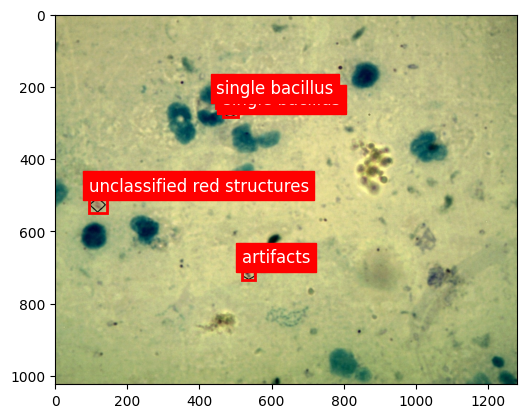

posx and posy should be finite values
posx and posy should be finite values


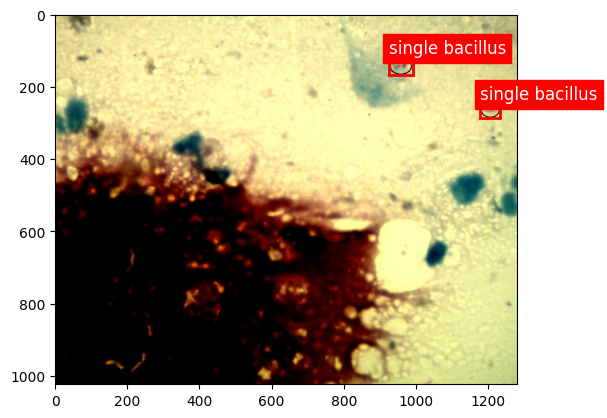

posx and posy should be finite values
posx and posy should be finite values


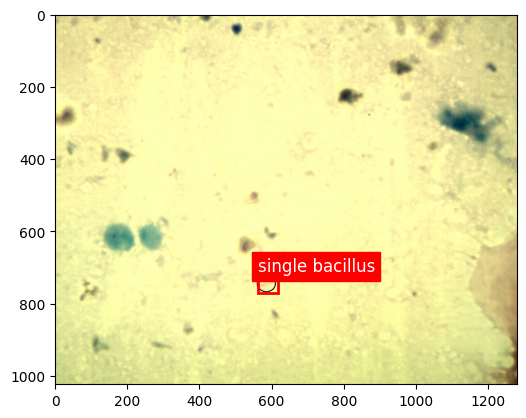

posx and posy should be finite values
posx and posy should be finite values


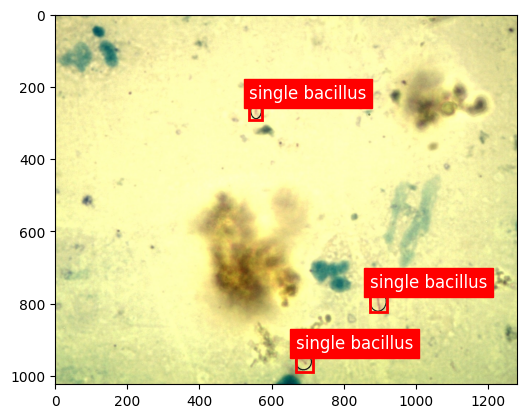

posx and posy should be finite values
posx and posy should be finite values


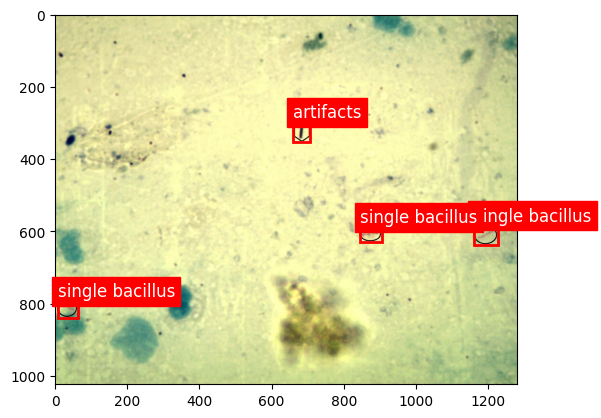

posx and posy should be finite values
posx and posy should be finite values


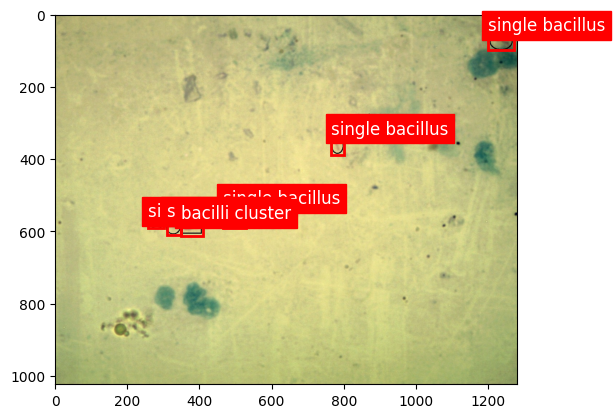

posx and posy should be finite values
posx and posy should be finite values


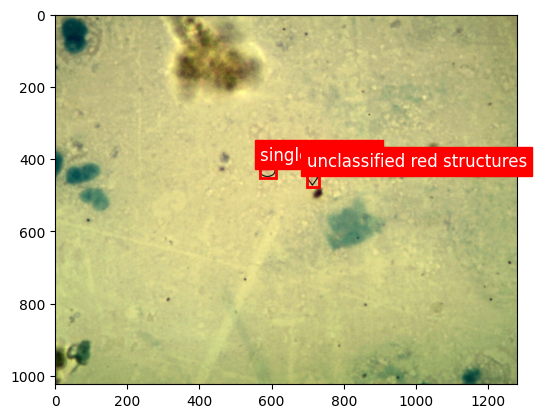

posx and posy should be finite values
posx and posy should be finite values


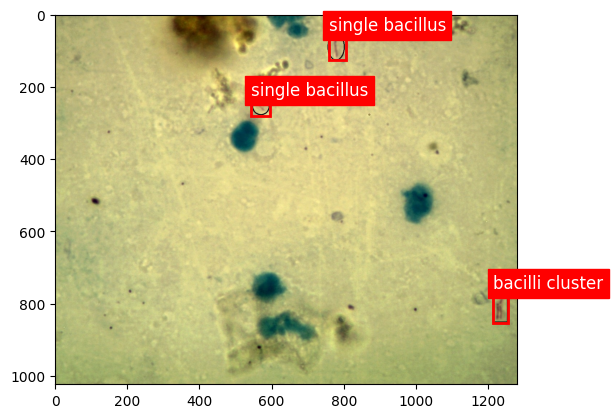

posx and posy should be finite values
posx and posy should be finite values


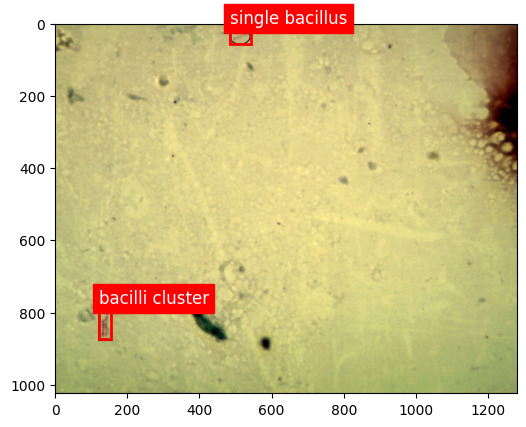

posx and posy should be finite values
posx and posy should be finite values


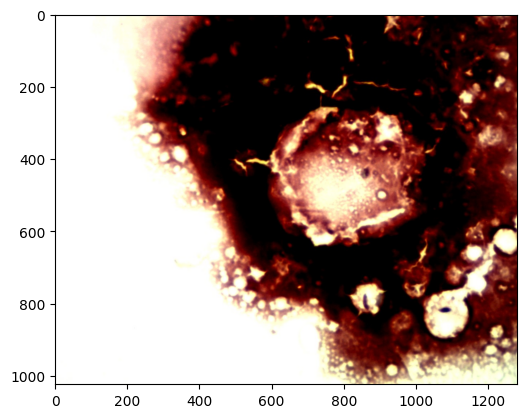

posx and posy should be finite values
posx and posy should be finite values


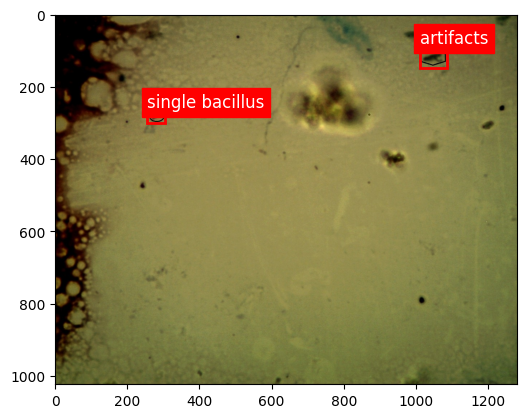

posx and posy should be finite values
posx and posy should be finite values


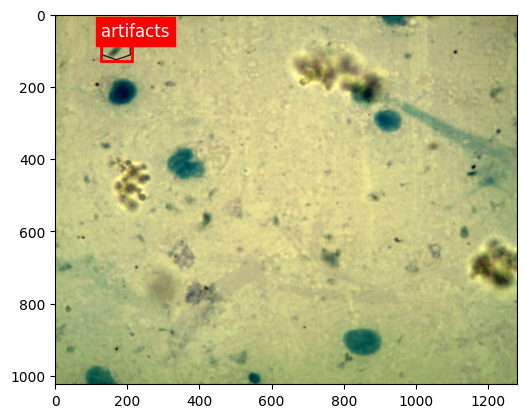

posx and posy should be finite values
posx and posy should be finite values


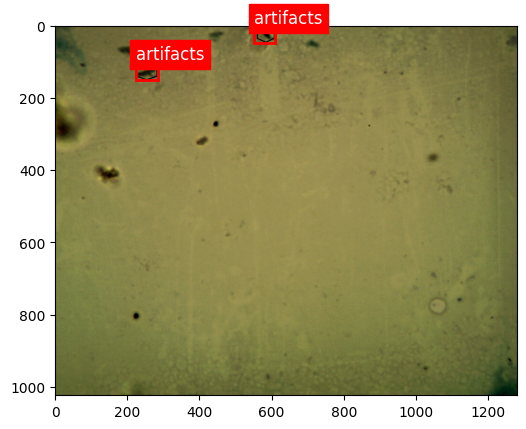

posx and posy should be finite values
posx and posy should be finite values


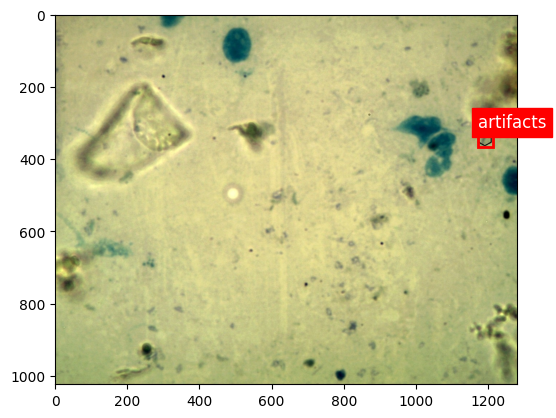

posx and posy should be finite values
posx and posy should be finite values


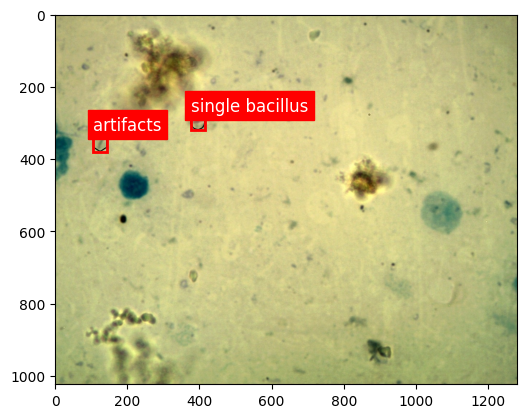

posx and posy should be finite values
posx and posy should be finite values


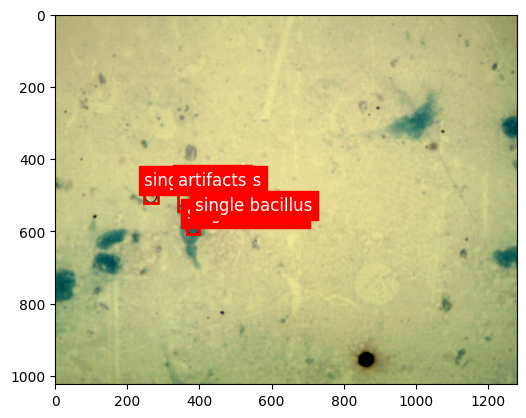

posx and posy should be finite values
posx and posy should be finite values


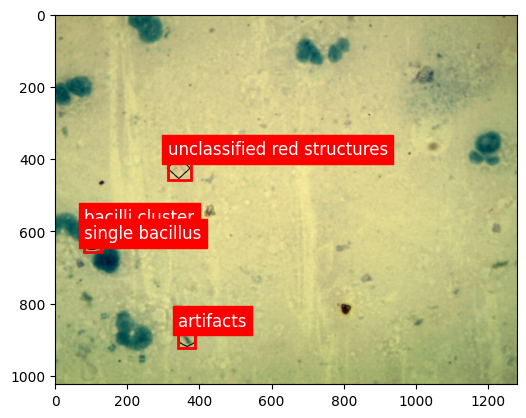

In [23]:
import os
import cv2
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.patches as patches

# Function to label image objects using annotations
def label_image_objects(img_file, annot_fold_path):
    # Construct annotation filename by replacing '.jpg' with '_annot.csv'
    annot_file = img_file.replace('.jpg', '_annot.csv')
    annot_file_path = os.path.join(annot_fold_path, annot_file)
    
    # Define annotation columns based on your format
    annot_cols = ['Label', 'x_st_pt', 'y_st_pt', 'box_width', 'box_height', 'Image_name', 'Image_width', 'Image_height']
    
    # Read the CSV, ensure numeric conversion
    lbl_data = pd.read_csv(annot_file_path, names=annot_cols)
    lbl_data['x_st_pt'] = pd.to_numeric(lbl_data['x_st_pt'], errors='coerce')
    lbl_data['y_st_pt'] = pd.to_numeric(lbl_data['y_st_pt'], errors='coerce')
    lbl_data['box_width'] = pd.to_numeric(lbl_data['box_width'], errors='coerce')
    lbl_data['box_height'] = pd.to_numeric(lbl_data['box_height'], errors='coerce')
    
    return lbl_data

# Function to visualize image with bounding boxes
def visualize_detection(image, boxes, labels=None):
    """
    Visualizes the bounding boxes on the image.
    
    Args:
        image (numpy array): Input image in RGB format.
        boxes (list of lists): Bounding boxes in format [x_min, y_min, x_max, y_max].
        labels (list, optional): Labels for each bounding box.
    """
    fig, ax = plt.subplots(1)
    ax.imshow(image)

    # Plot each bounding box
    for i, box in enumerate(boxes):
        x_min, y_min, x_max, y_max = box
        width, height = x_max - x_min, y_max - y_min
        rect = patches.Rectangle((x_min, y_min), width, height, linewidth=2, edgecolor='r', facecolor='none')
        ax.add_patch(rect)

        # Add labels if available
        if labels:
            plt.text(x_min, y_min - 10, f'{labels[i]}', color='white', fontsize=12, backgroundcolor='red')

    plt.show()

# Example usage of the paths
main_fold = r"C:\Users\JEEVANANTHAM\Downloads\bacilli_count\code\baci-count\data\train-test"  # Replace with your main directory path
folder = "Mannual_Microscope-2_set1"  # Replace with the subfolder name

# Construct the full paths
fold_path = os.path.join(main_fold, folder)
img_fold_path = os.path.join(fold_path, 'Images')
annot_fold_path = os.path.join(fold_path, 'Annotations')

# List all image files in the directory
img_files = os.listdir(img_fold_path)

# Process each image
for img_file in img_files:
    img_file_path = os.path.join(img_fold_path, img_file)
    
    # Load image
    image = cv2.imread(img_file_path)
    
    if image is None:
        print(f"Warning: Unable to read image {img_file_path}")
        continue
    
    # Convert to RGB for visualization
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    
    # Load annotations for this image
    img_lbl = label_image_objects(img_file, annot_fold_path)
    
    # Extract bounding boxes and labels from annotations
    boxes = []
    labels = []
    for _, row in img_lbl.iterrows():
        x_min = row['x_st_pt']
        y_min = row['y_st_pt']
        x_max = x_min + row['box_width']
        y_max = y_min + row['box_height']
        boxes.append([x_min, y_min, x_max, y_max])
        labels.append(row['Label'])
    
    # Visualize the image with bounding boxes
    visualize_detection(image_rgb, boxes, labels)


In [24]:
def visualize_images(orig_img, img_seg, img_pp, img_pp_lbl):
    # Create a figure with subplots
    fig, axs = plt.subplots(2, 2, figsize=(12, 10))
    
    # Original image
    axs[0, 0].imshow(cv2.cvtColor(orig_img, cv2.COLOR_BGR2RGB))
    axs[0, 0].set_title("Original Image")
    axs[0, 0].axis("off")
    
    # Segmented image
    axs[0, 1].imshow(img_seg, cmap='gray')
    axs[0, 1].set_title("Segmented Image")
    axs[0, 1].axis("off")
    
    # Post-processed image
    axs[1, 0].imshow(img_pp, cmap='gray')
    axs[1, 0].set_title("Post-Processed Image")
    axs[1, 0].axis("off")
    
    # Post-processed image with labels
    axs[1, 1].imshow(cv2.cvtColor(img_pp_lbl, cv2.COLOR_GRAY2RGB))
    axs[1, 1].set_title("Post-Processed with Labels")
    axs[1, 1].axis("off")
    
    plt.tight_layout()
    plt.show()


In [28]:
def label_image_objects(img_file, annot_fold_path):
    annot_file = img_file[:-4] + '_annot.csv'
    annot_file_path = os.path.join(annot_fold_path, annot_file)

    annot_cols = ["Label", "x_st_pt", "y_st_pt", "box_width", "box_height", "Image_name", "Image_width", "Image_height"]

    lbl_data = pd.read_csv(annot_file_path, names=annot_cols, header=0)
    
    img_lbl = np.ones(orig_img_shape[:2], np.uint8) * 20

    for i in range(lbl_data.shape[0]):
        x_st_pt = lbl_data["x_st_pt"][i]
        y_st_pt = lbl_data["y_st_pt"][i]
        x_end_pt = x_st_pt + lbl_data["box_width"][i]
        y_end_pt = y_st_pt + lbl_data["box_height"][i]
        
        # Determine fill value based on label
        if lbl_data["Label"][i] == "single bacillus":
            fill_val = 50
        elif lbl_data["Label"][i] == "bacilli cluster":
            fill_val = 100
        elif lbl_data["Label"][i] == "unclassified red structures":
            fill_val = 150
        elif lbl_data["Label"][i] == "artifacts":
            fill_val = 200
        else:
            fill_val = 20  # Default fill value for unknown labels
        
        st_pt = (x_st_pt, y_st_pt)
        end_pt = (x_end_pt, y_end_pt)
        cv2.rectangle(img_lbl, st_pt, end_pt, fill_val, thickness=-1)
    
    img_lbl = cv2.resize(img_lbl, (img_shape[1], img_shape[0]))
    img_pp_lbl = cv2.bitwise_and(img_pp, img_lbl)
    
    return img_lbl, img_pp_lbl

img_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)
img_pp_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)


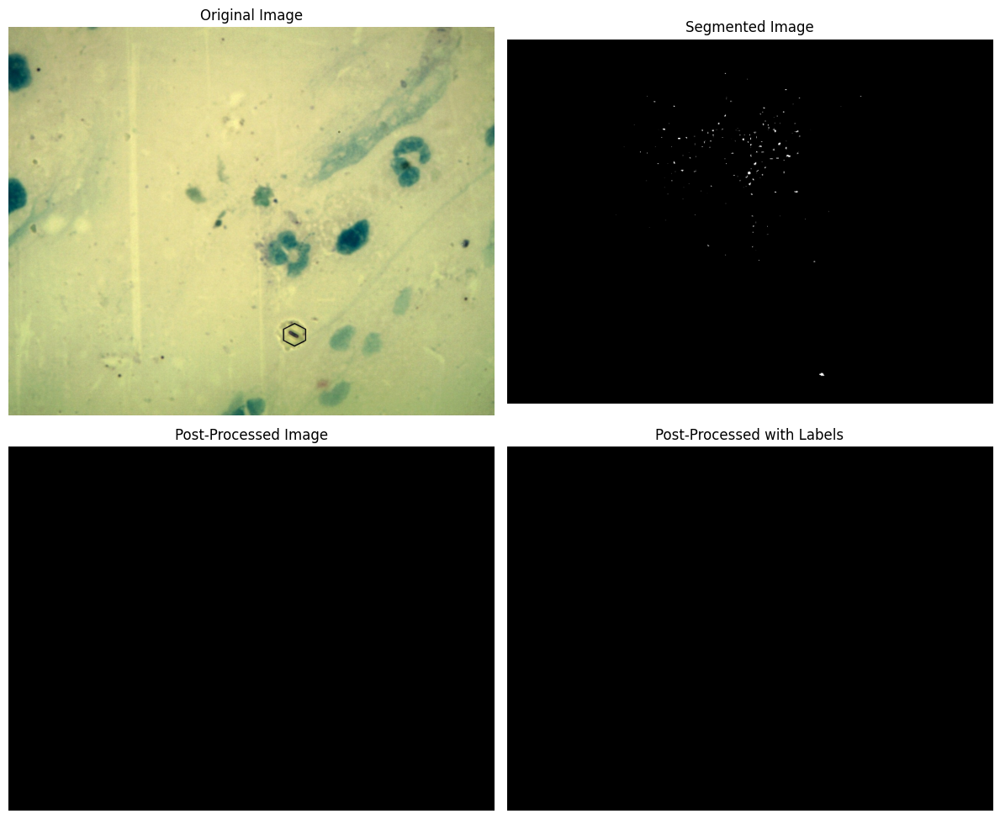

img_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)
img_pp_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)


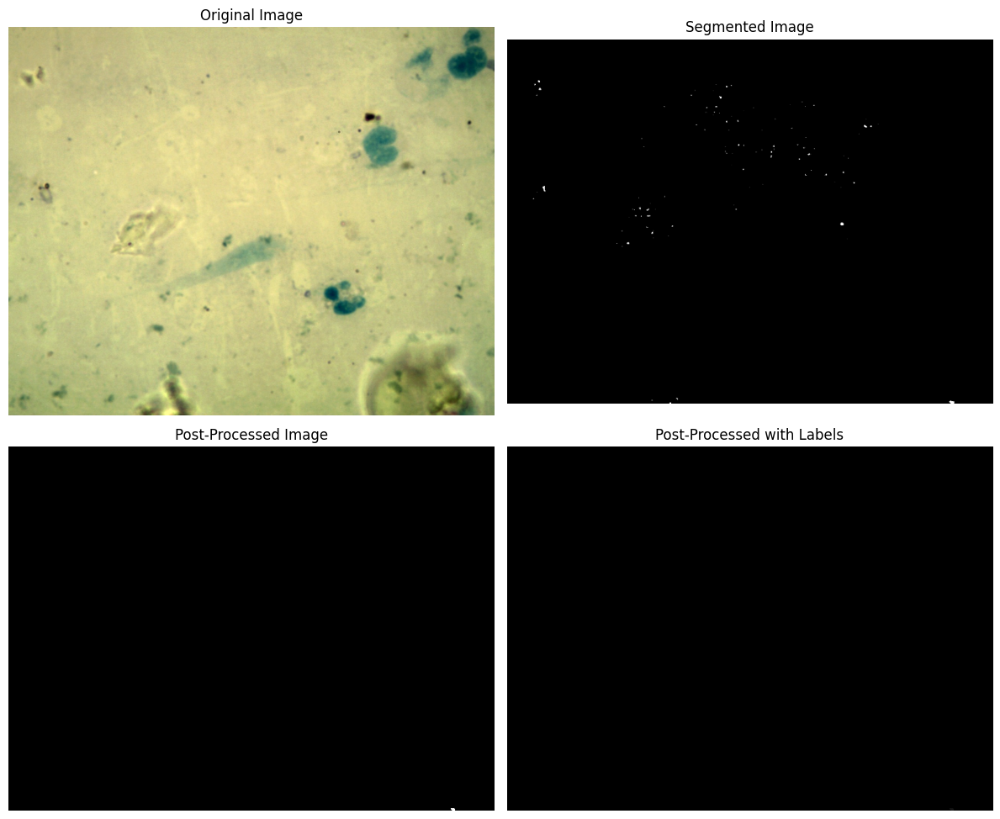

img_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)
img_pp_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)


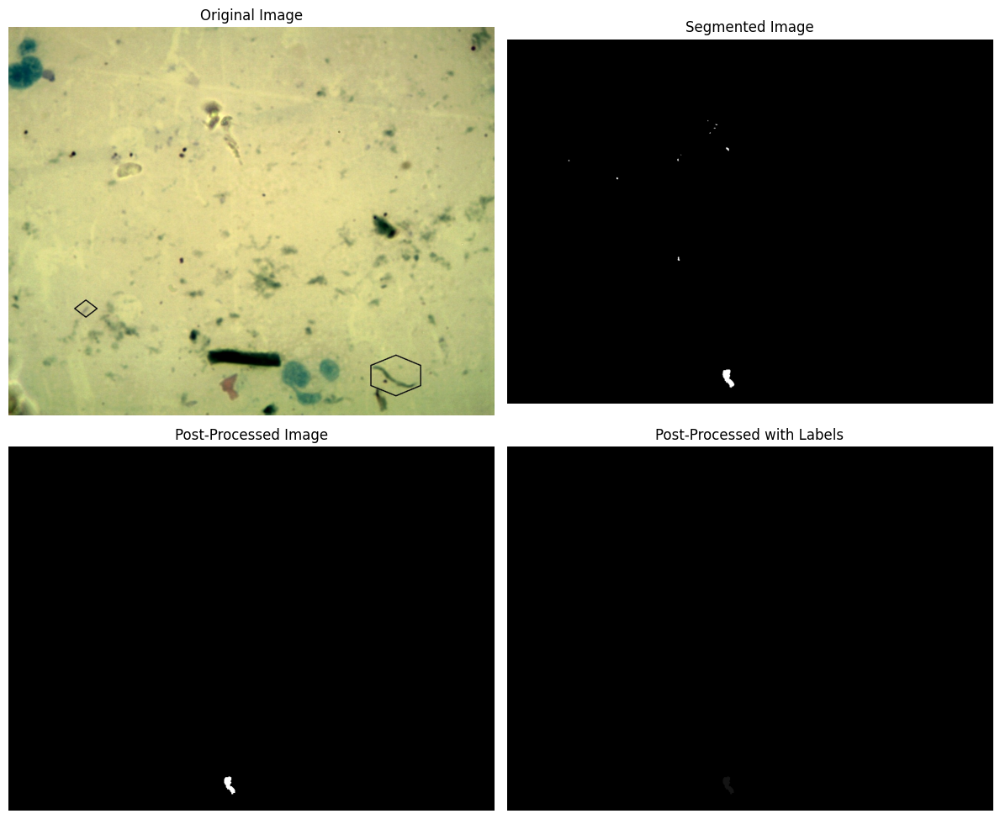

img_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)
img_pp_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)


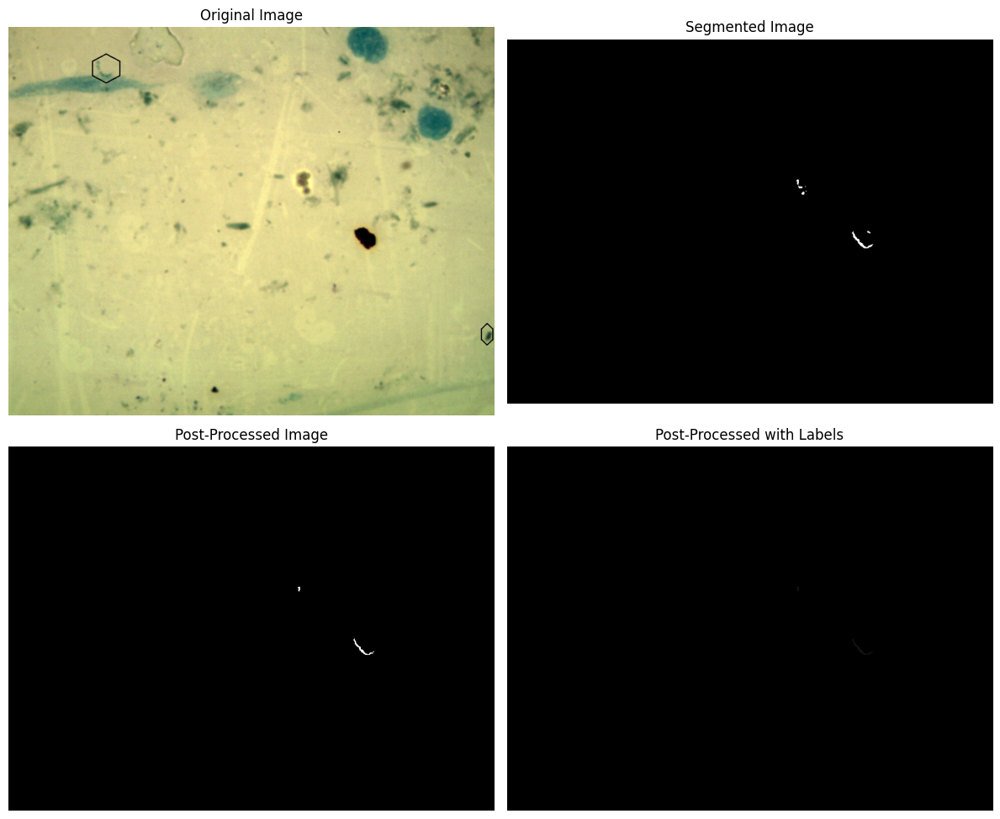

img_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)
img_pp_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)


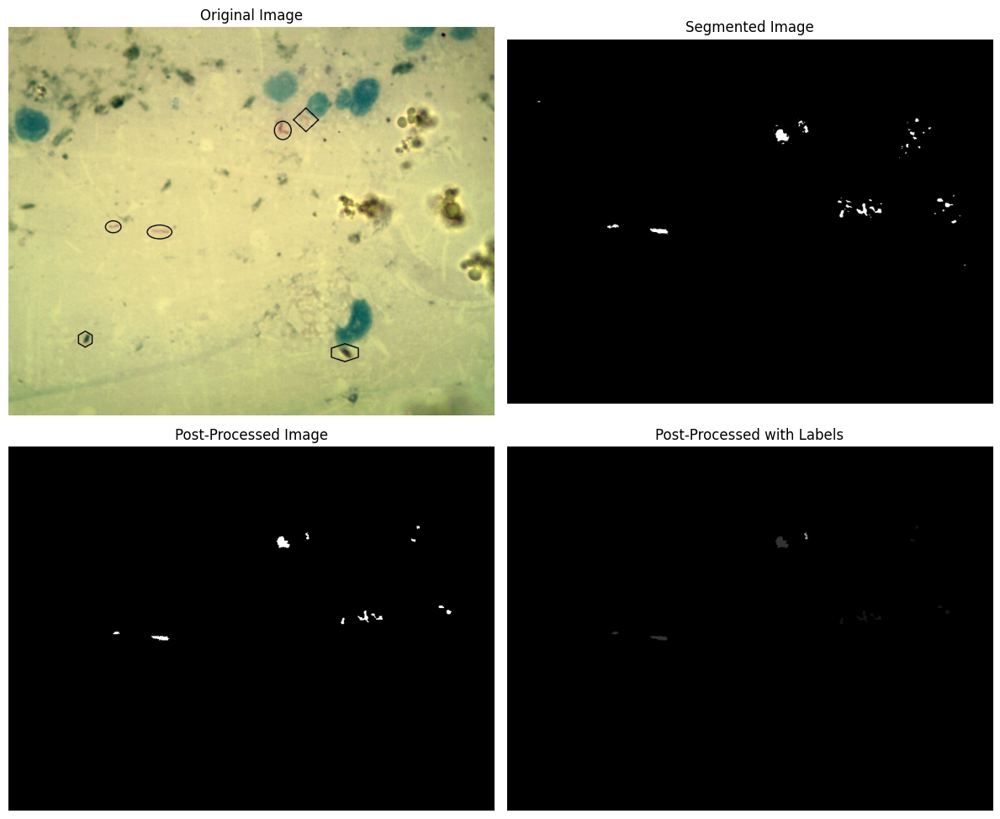

img_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)
img_pp_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)


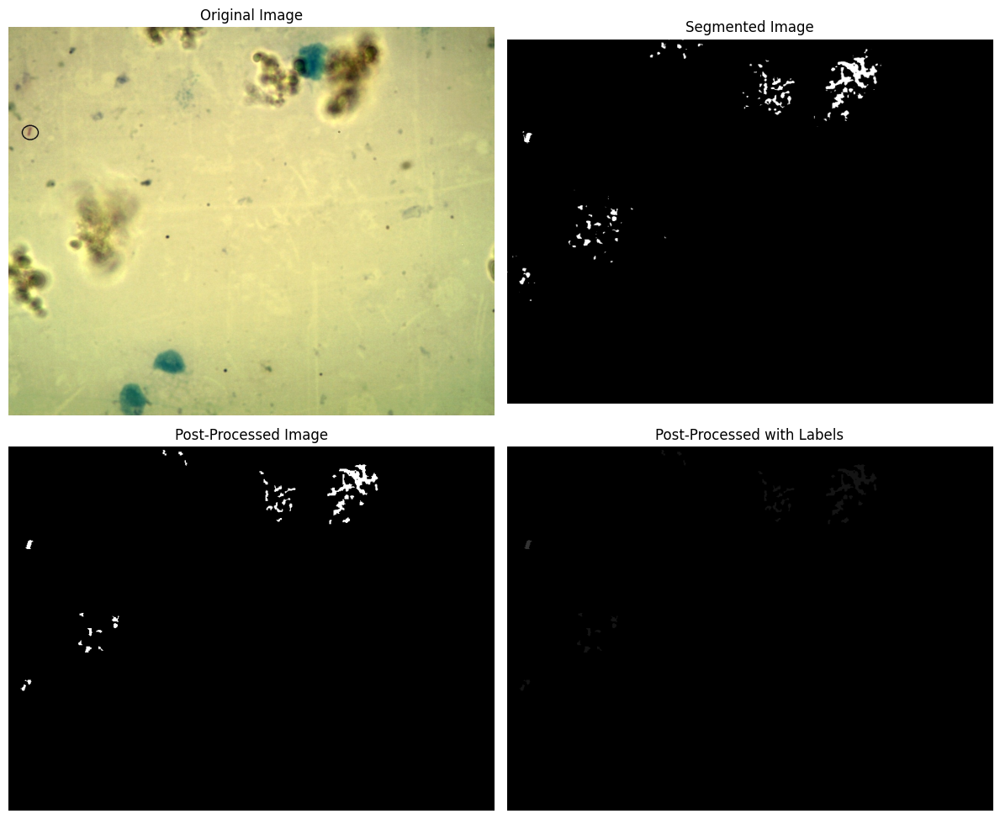

img_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)
img_pp_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)


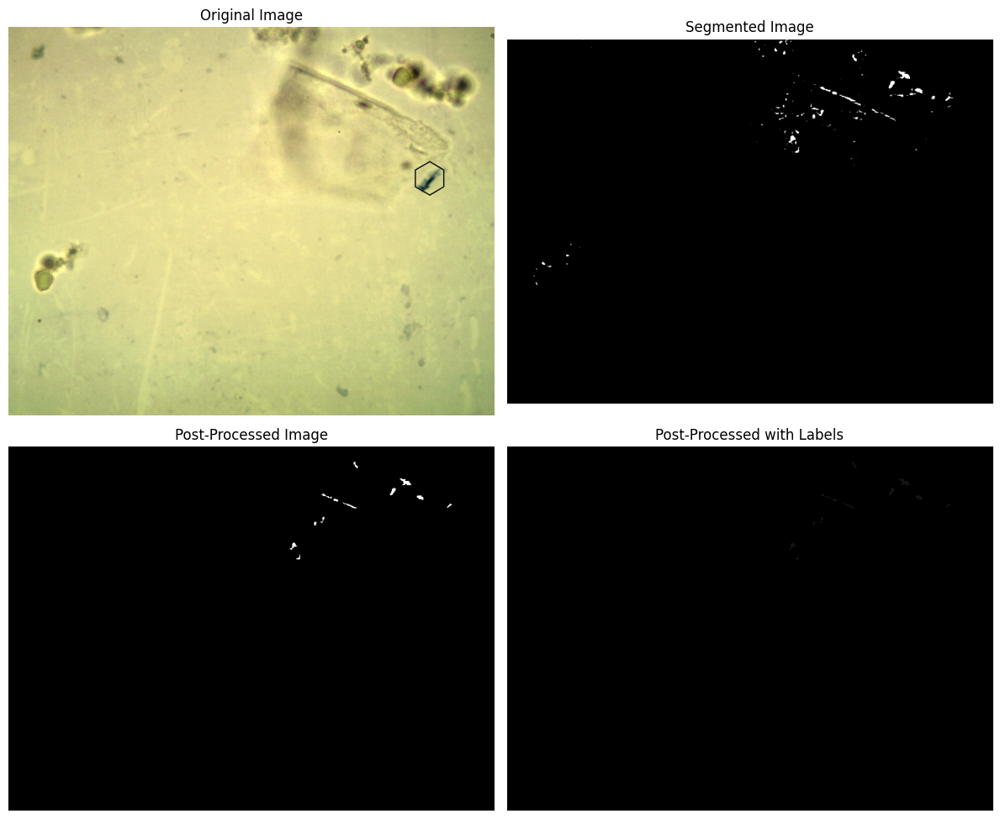

img_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)
img_pp_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)


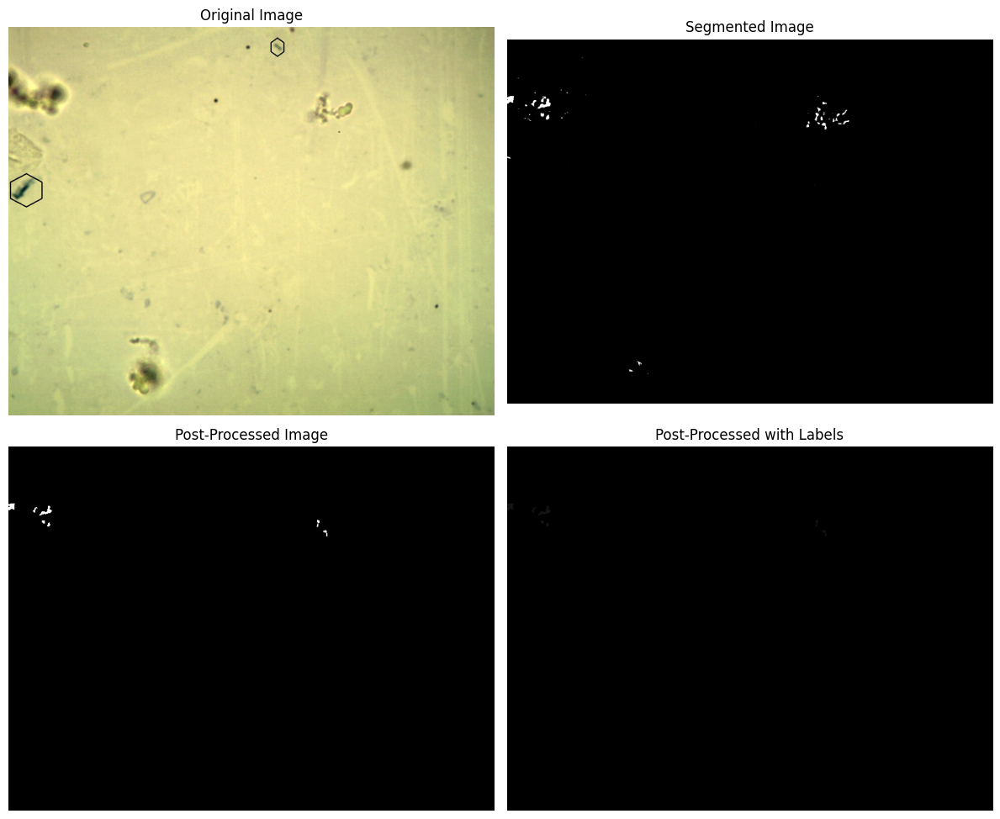

img_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)
img_pp_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)


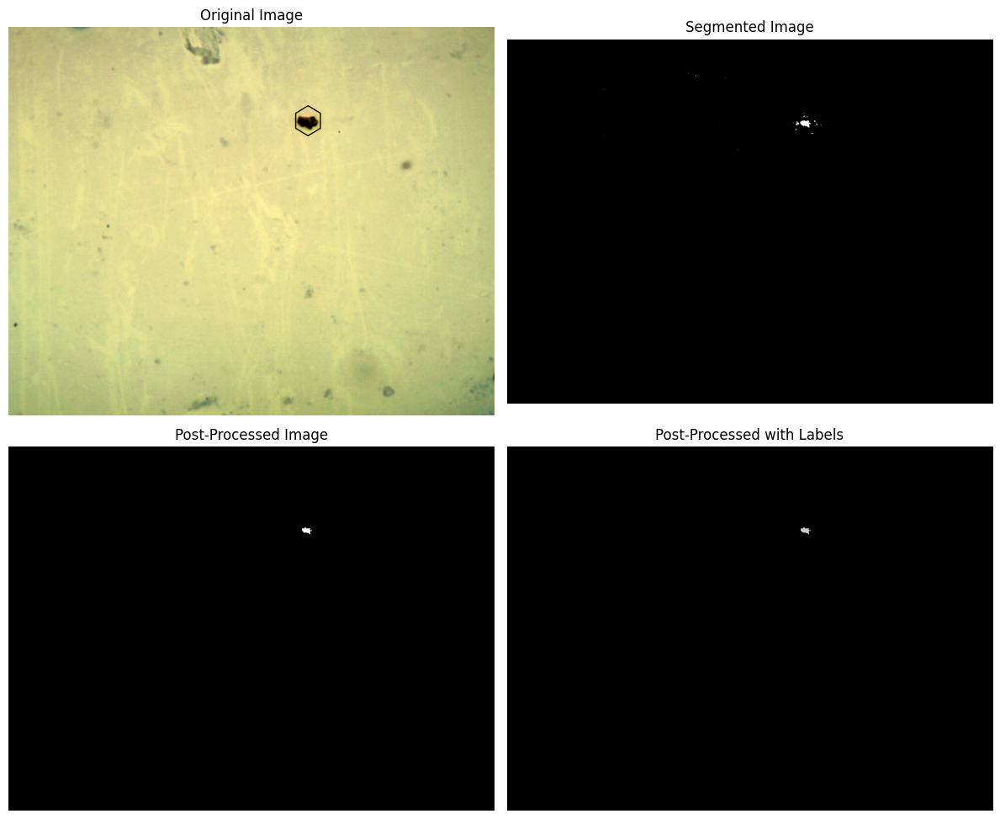

img_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)
img_pp_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)


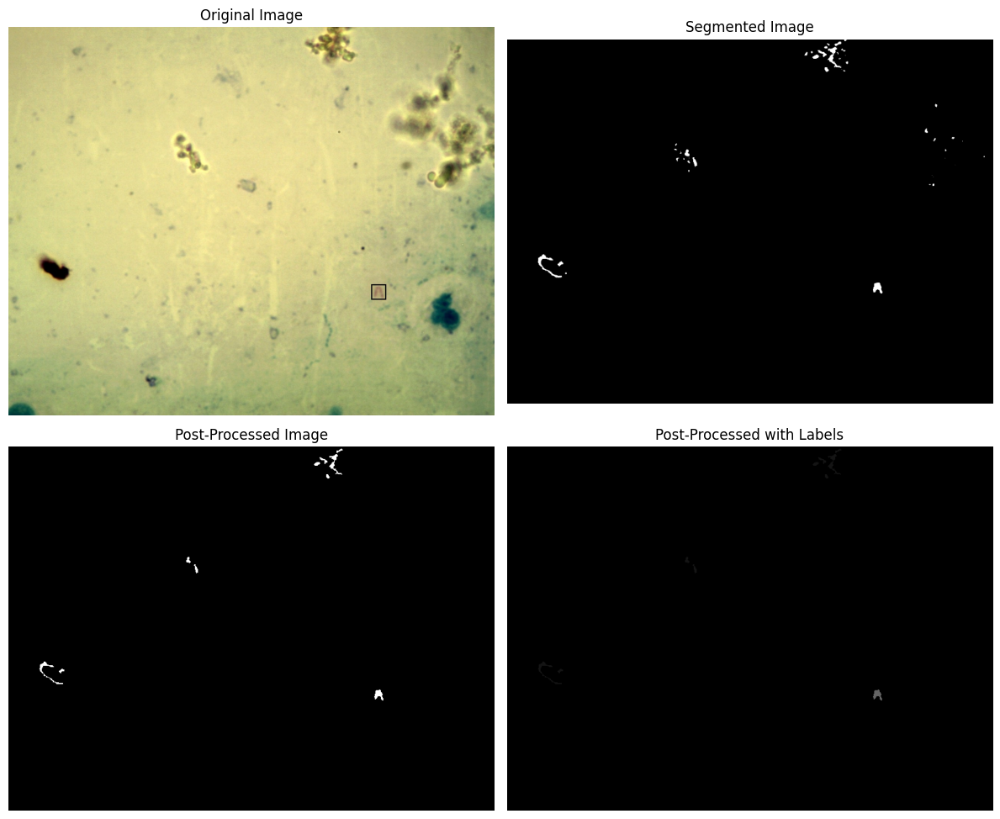

img_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)
img_pp_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)


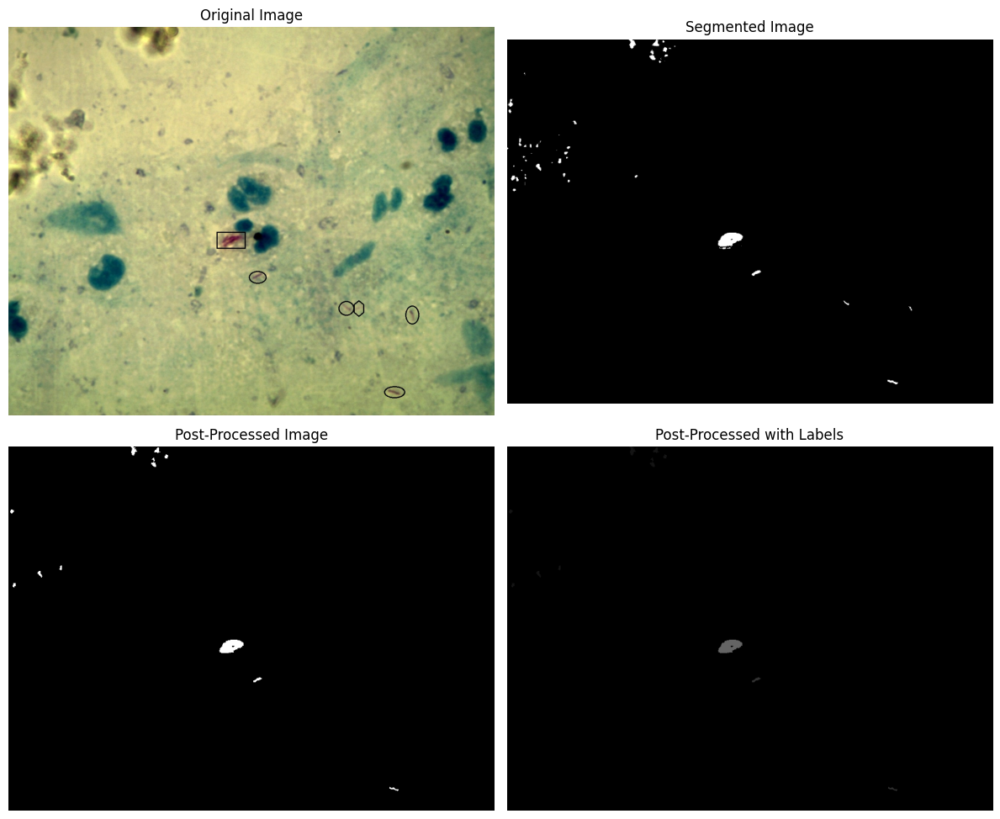

img_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)
img_pp_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)


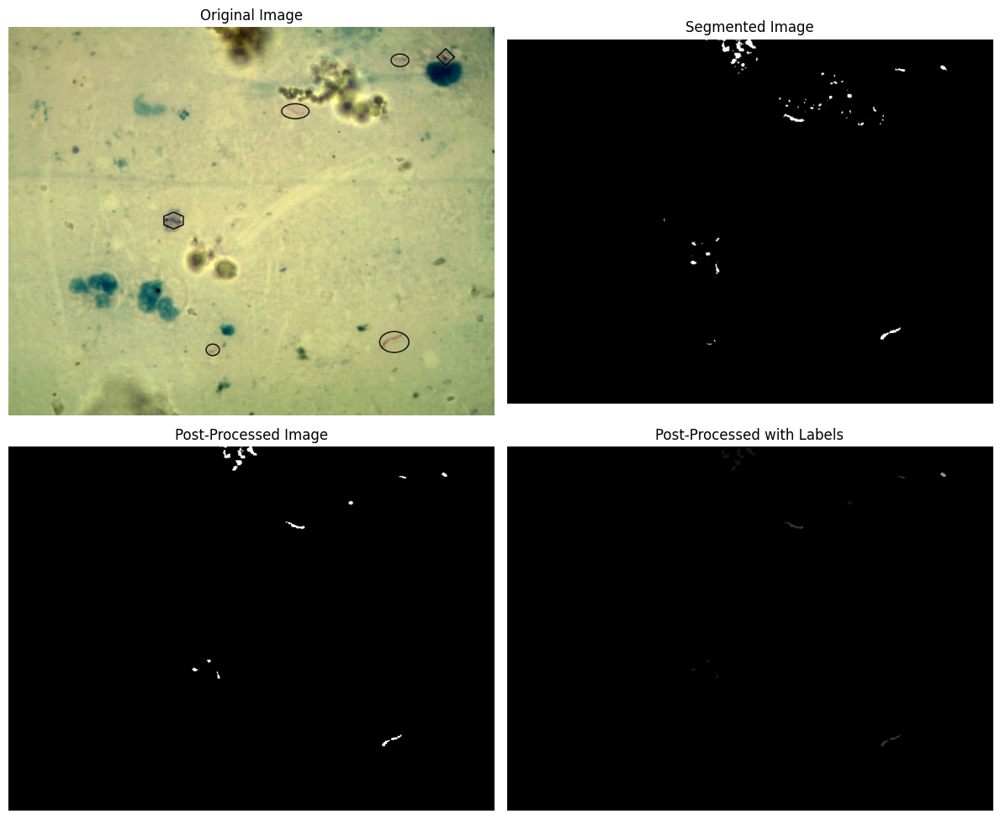

img_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)
img_pp_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)


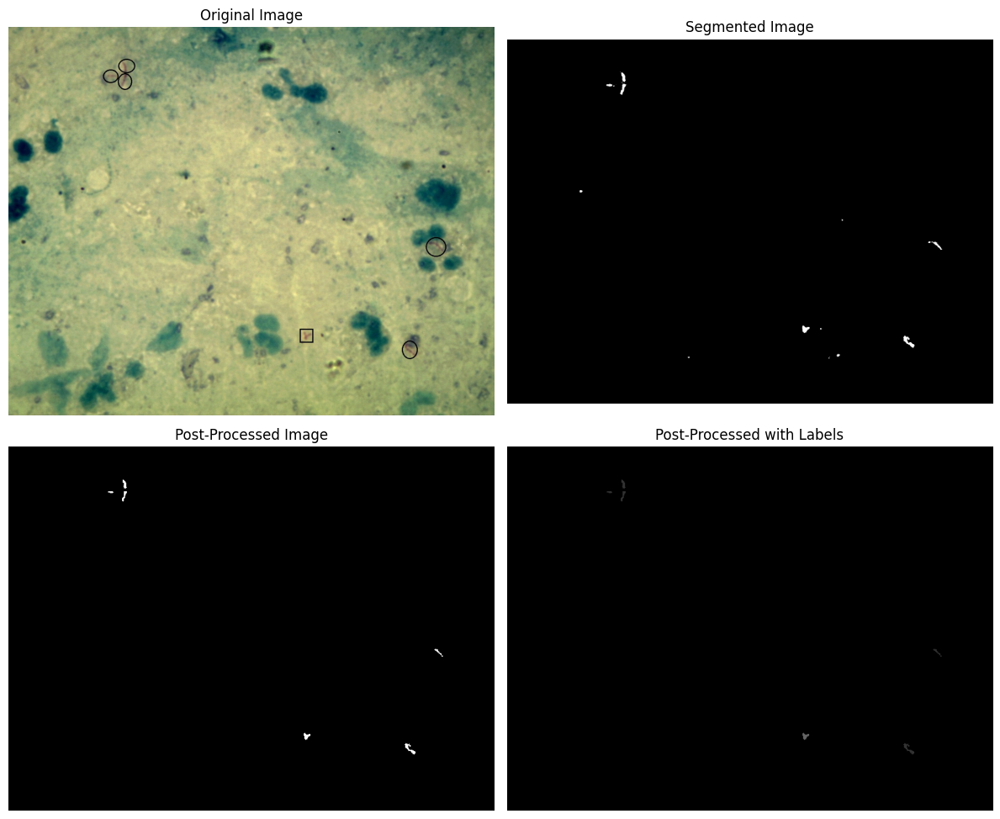

img_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)
img_pp_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)


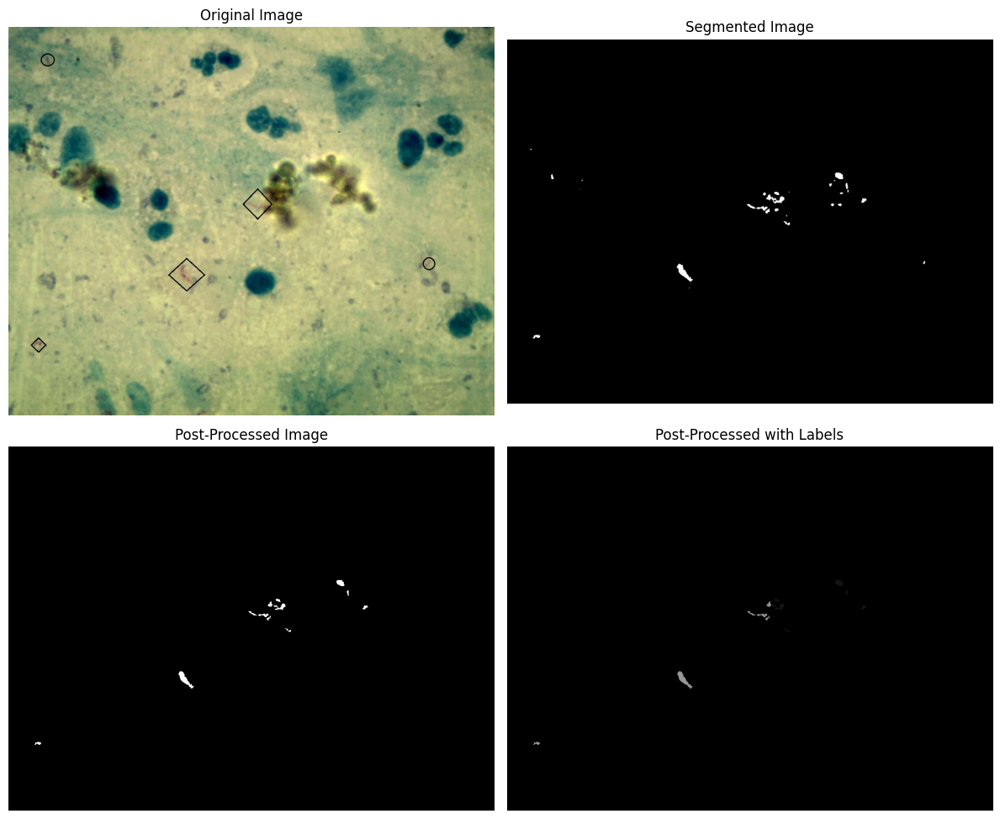

img_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)
img_pp_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)


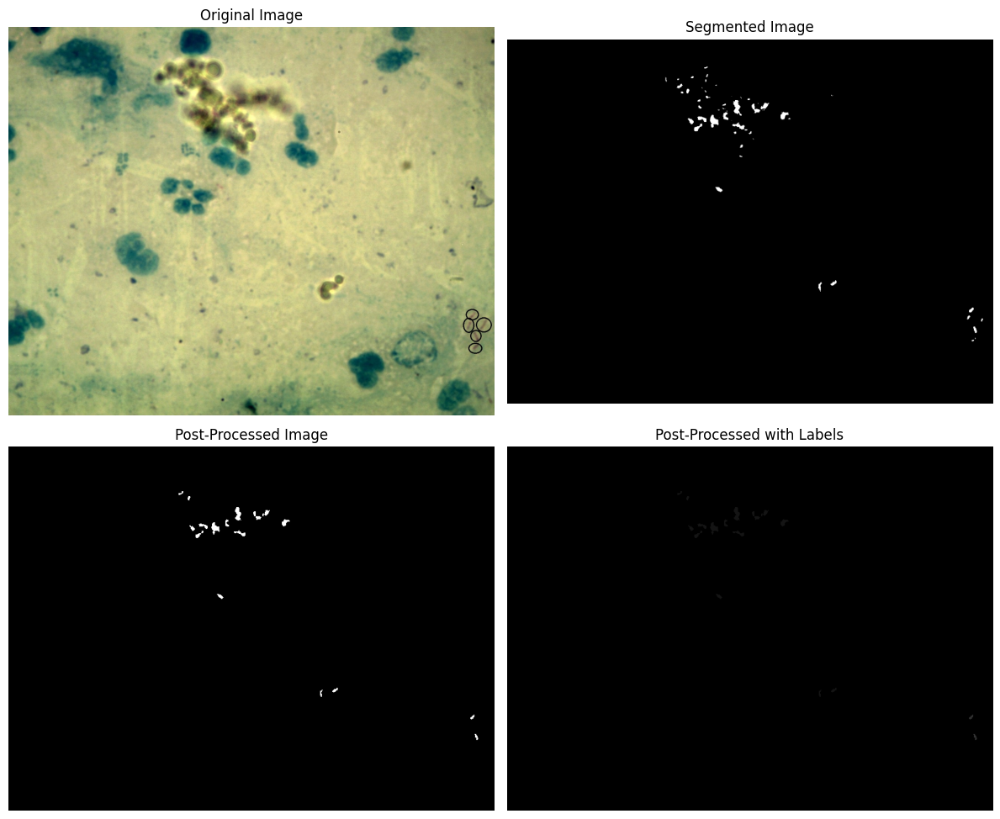

img_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)
img_pp_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)


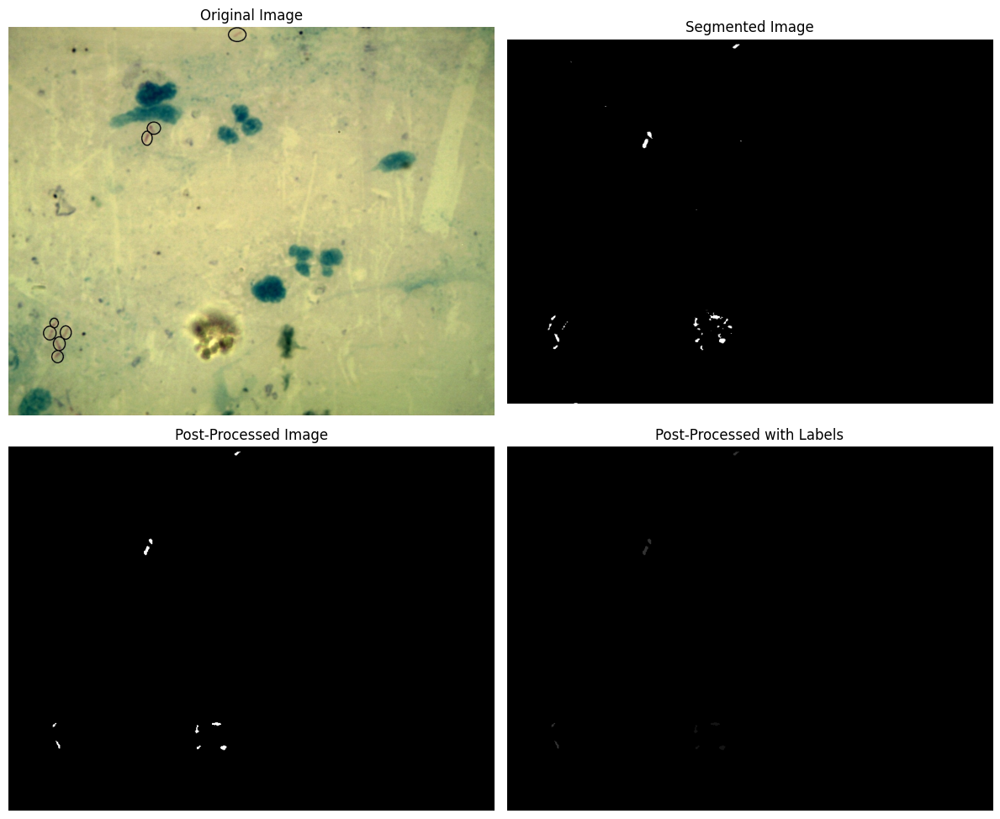

img_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)
img_pp_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)


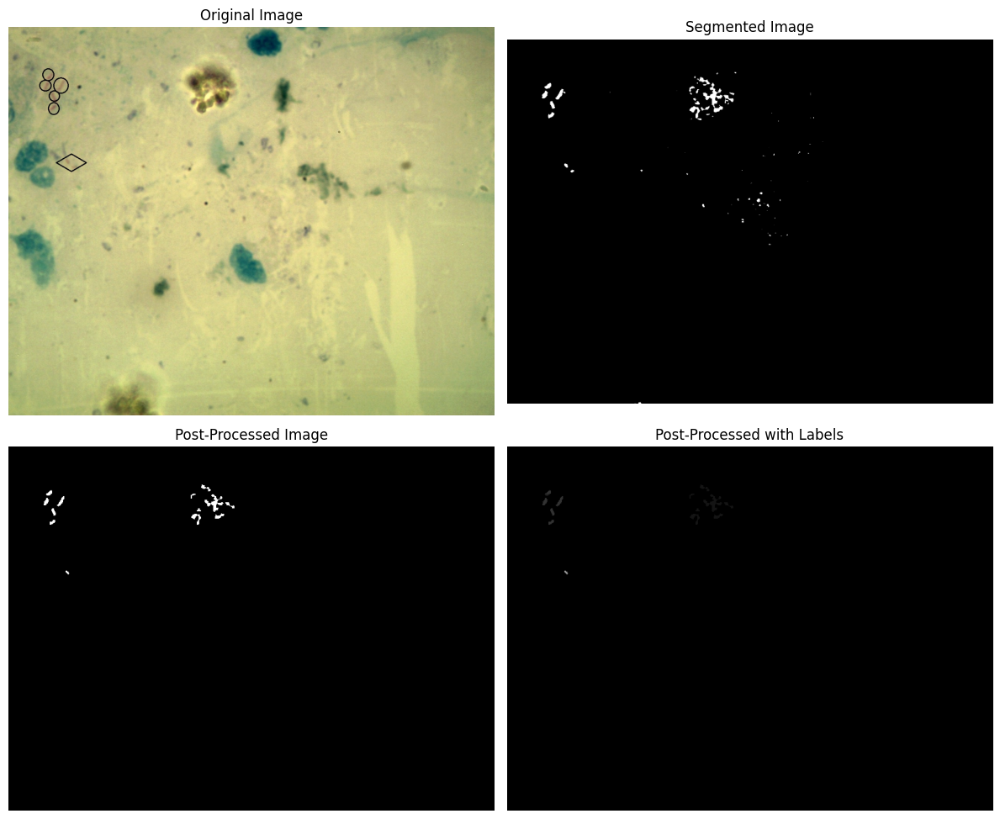

img_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)
img_pp_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)


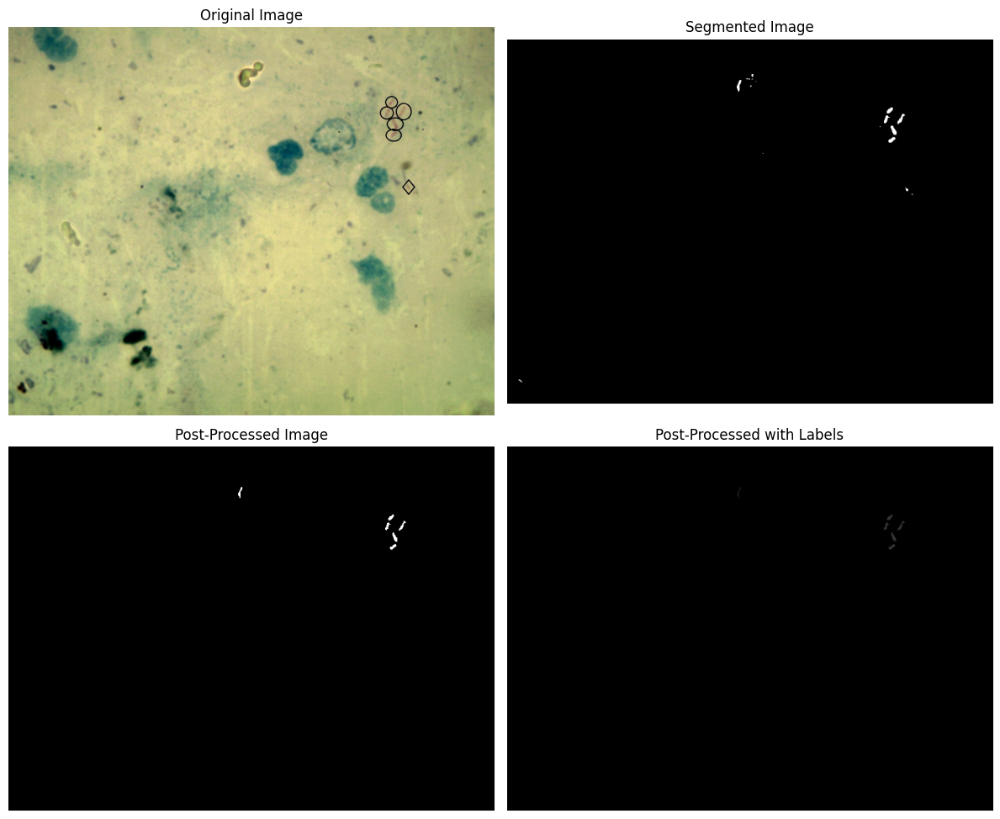

img_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)
img_pp_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)


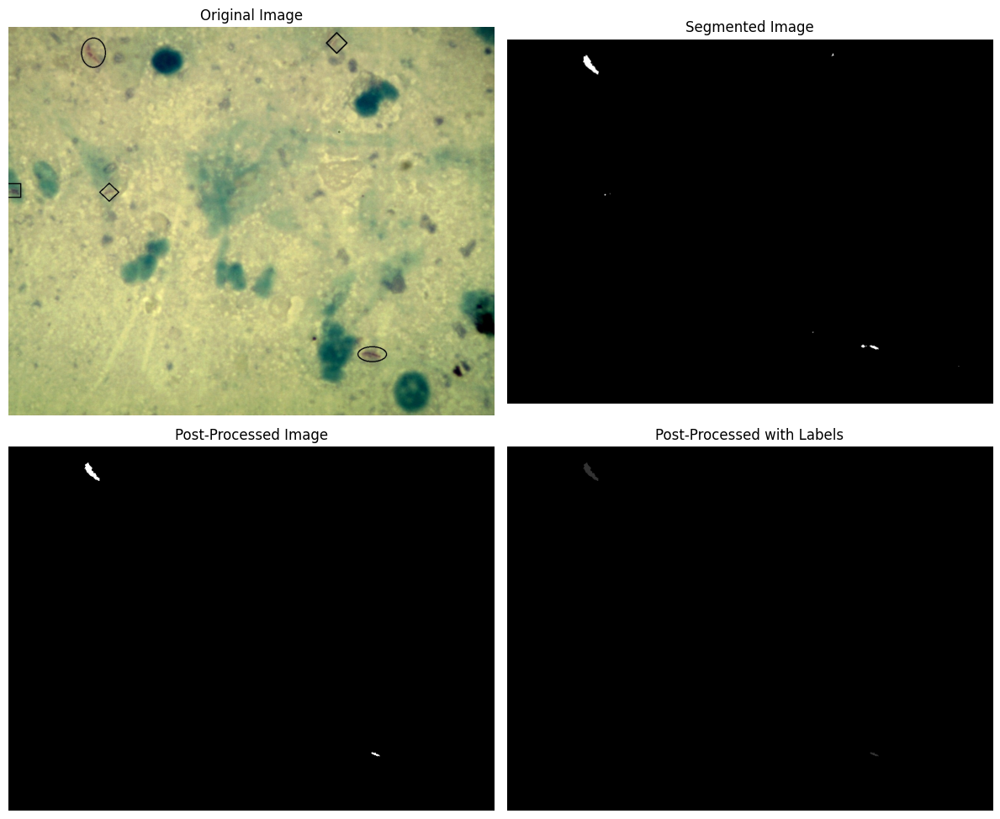

img_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)
img_pp_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)


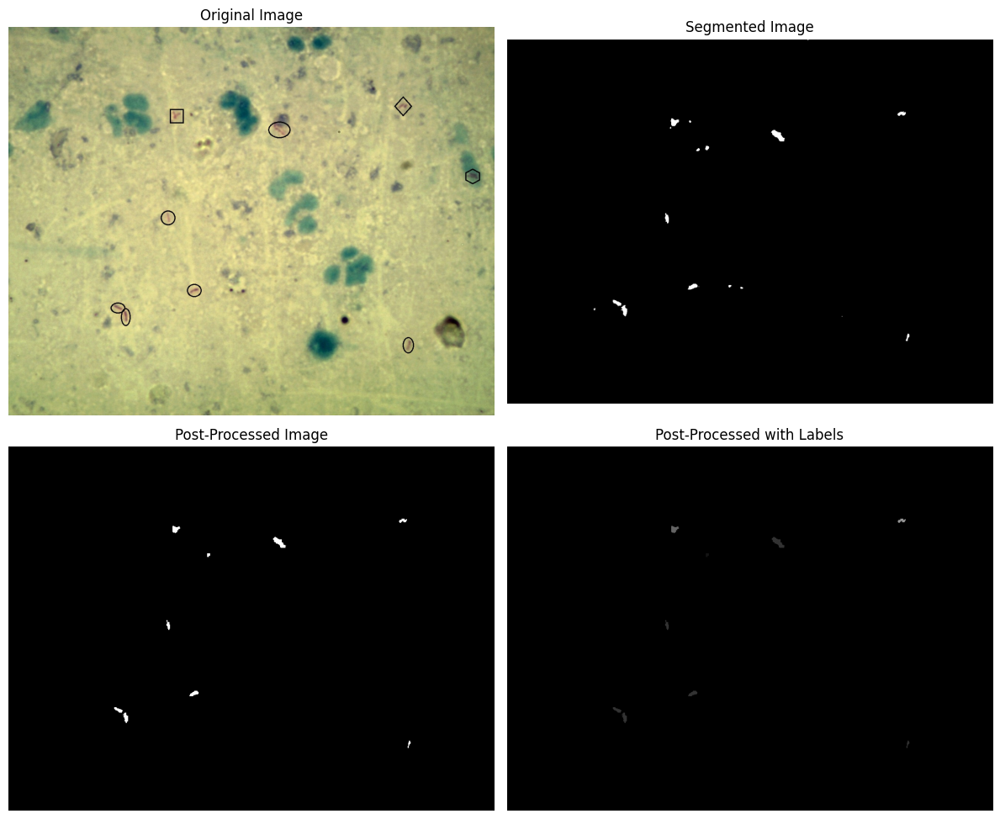

img_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)
img_pp_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)


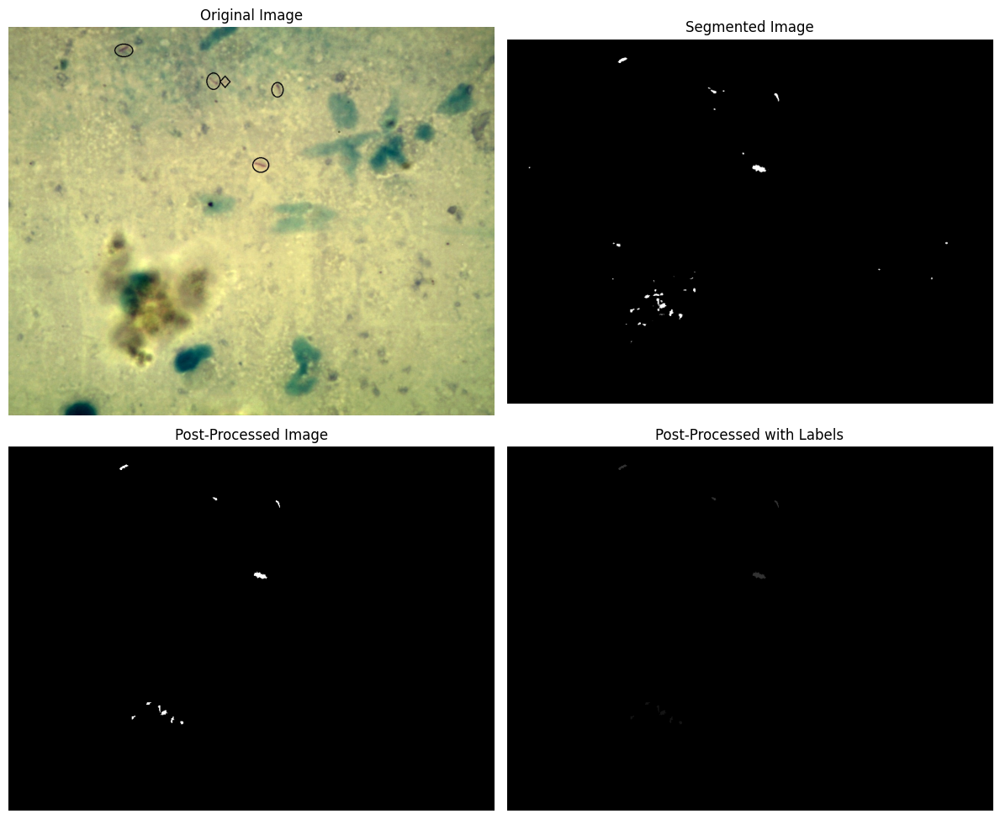

img_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)
img_pp_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)


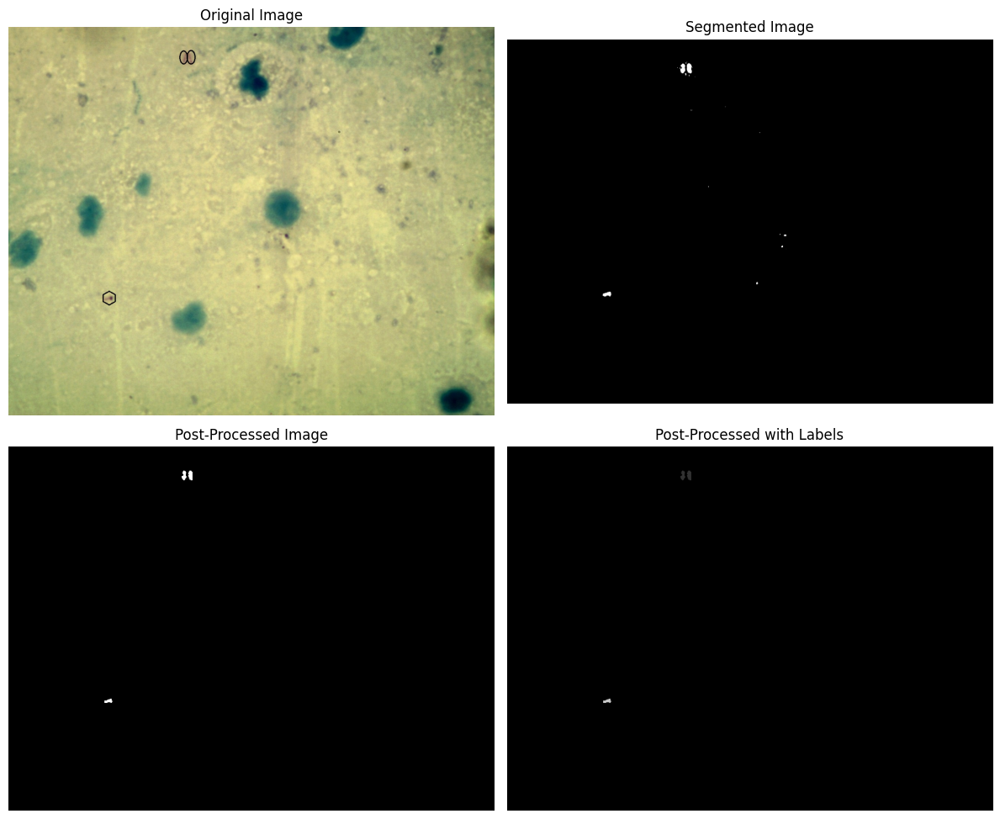

img_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)
img_pp_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)


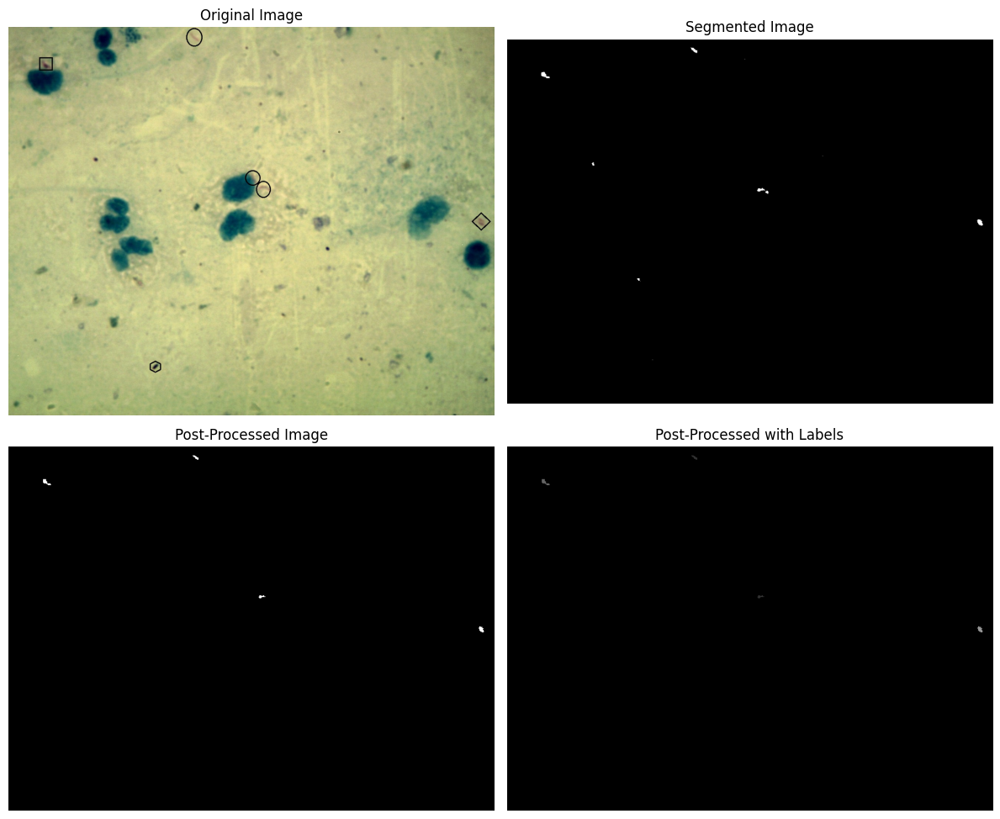

img_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)
img_pp_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)


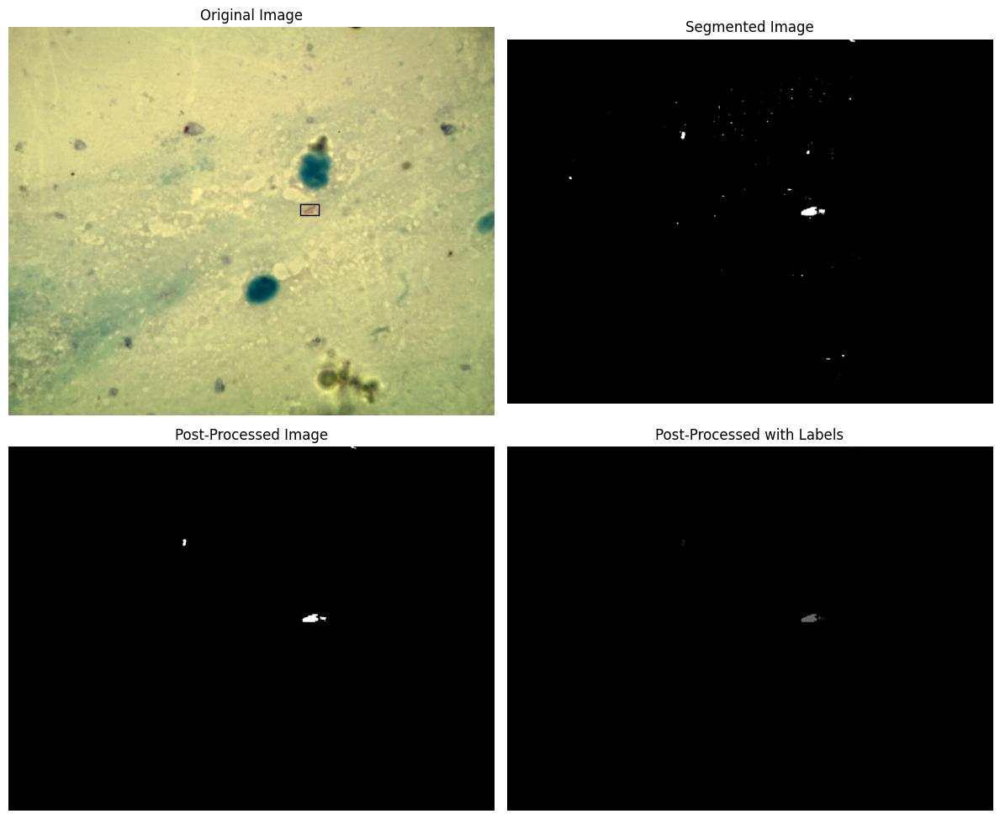

img_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)
img_pp_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)


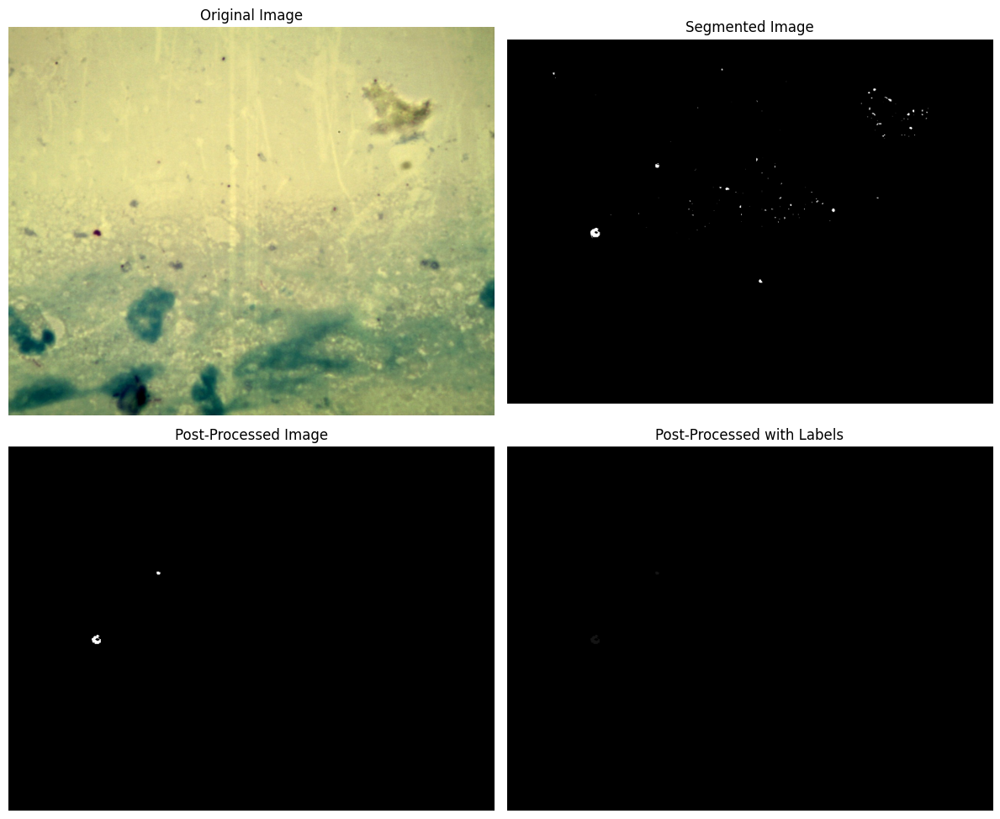

img_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)
img_pp_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)


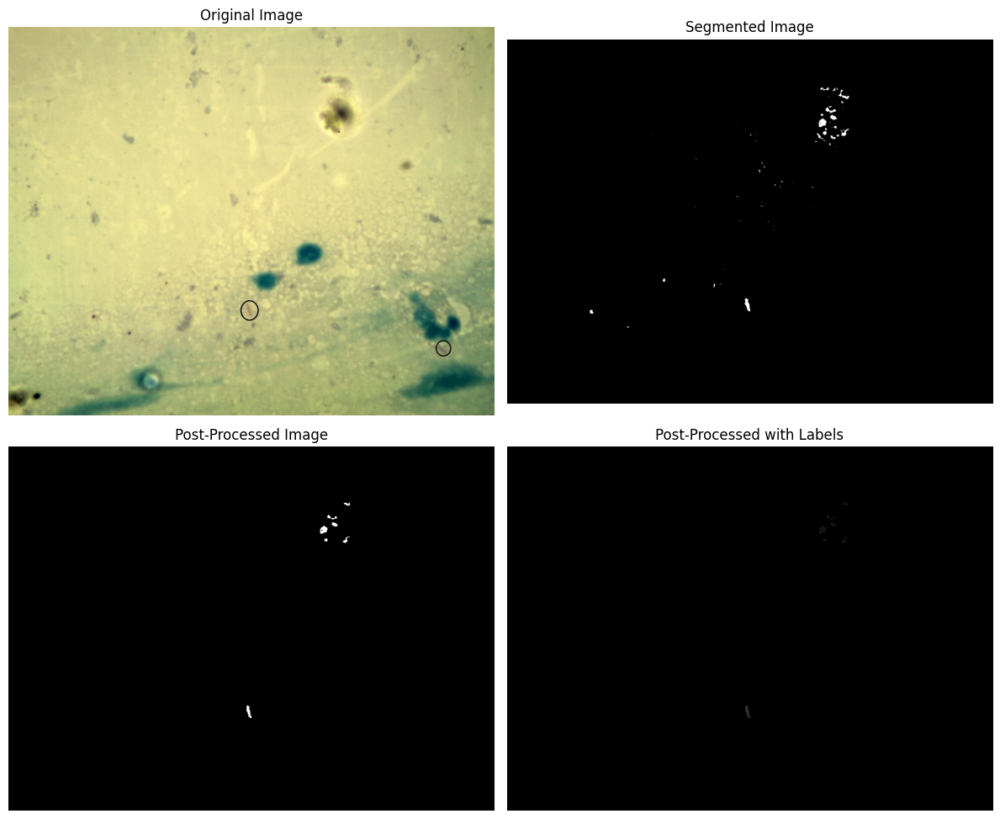

img_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)
img_pp_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)


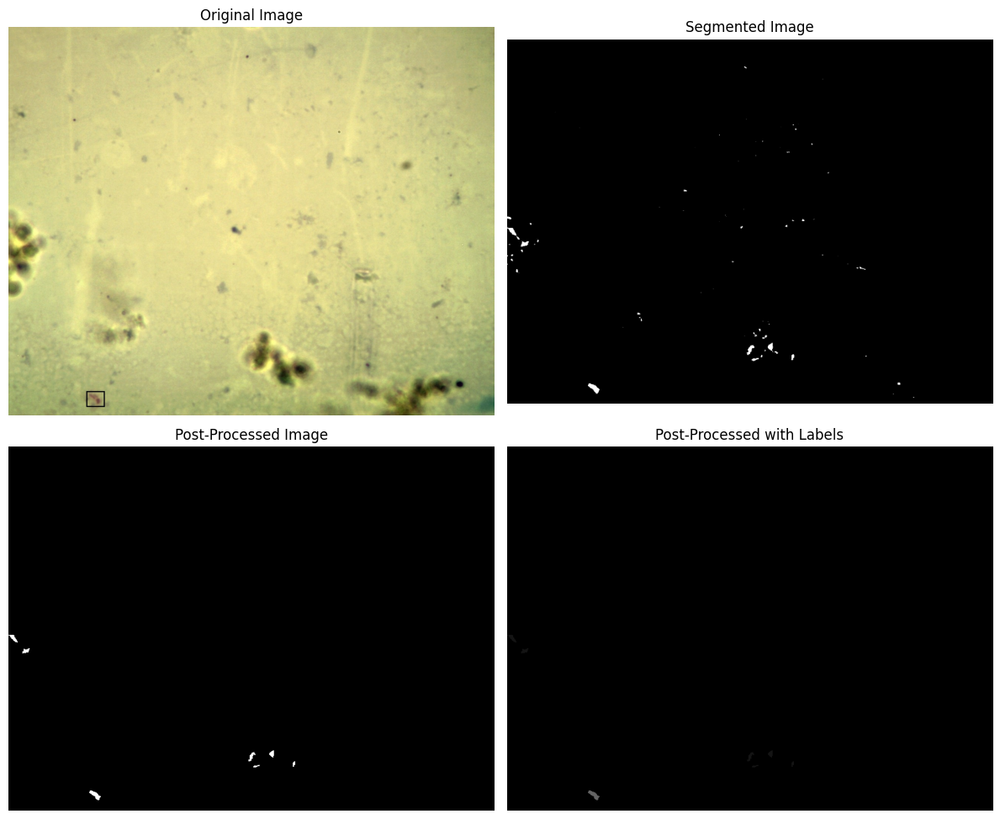

img_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)
img_pp_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)


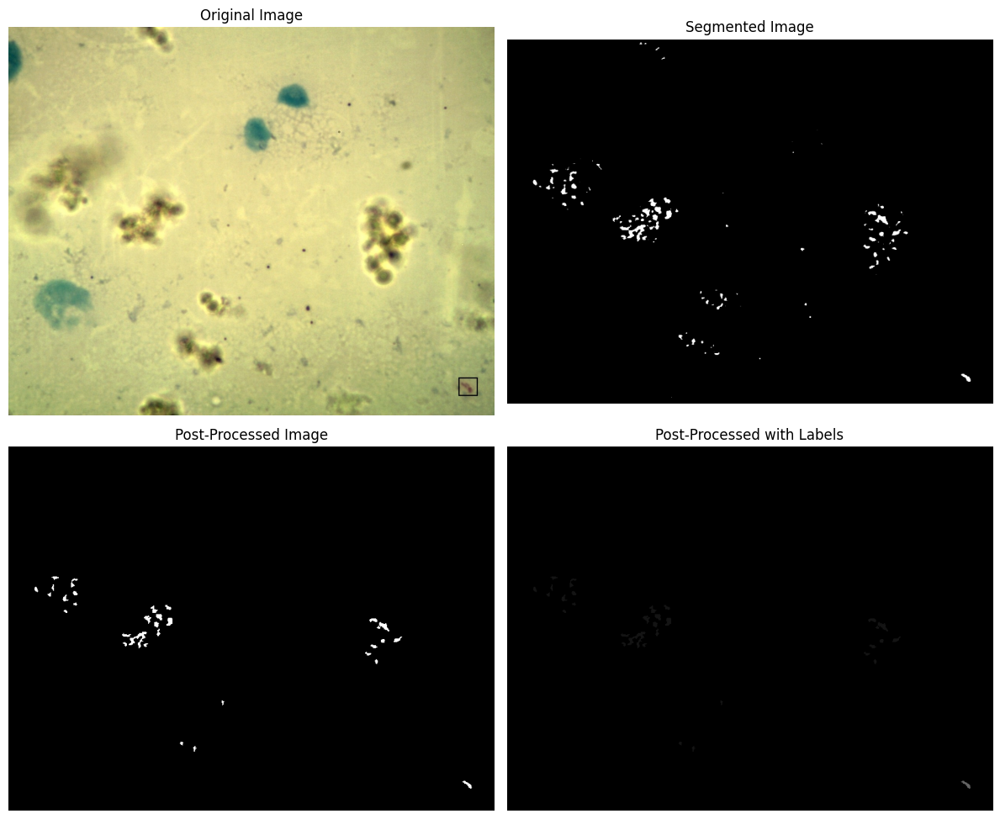

img_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)
img_pp_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)


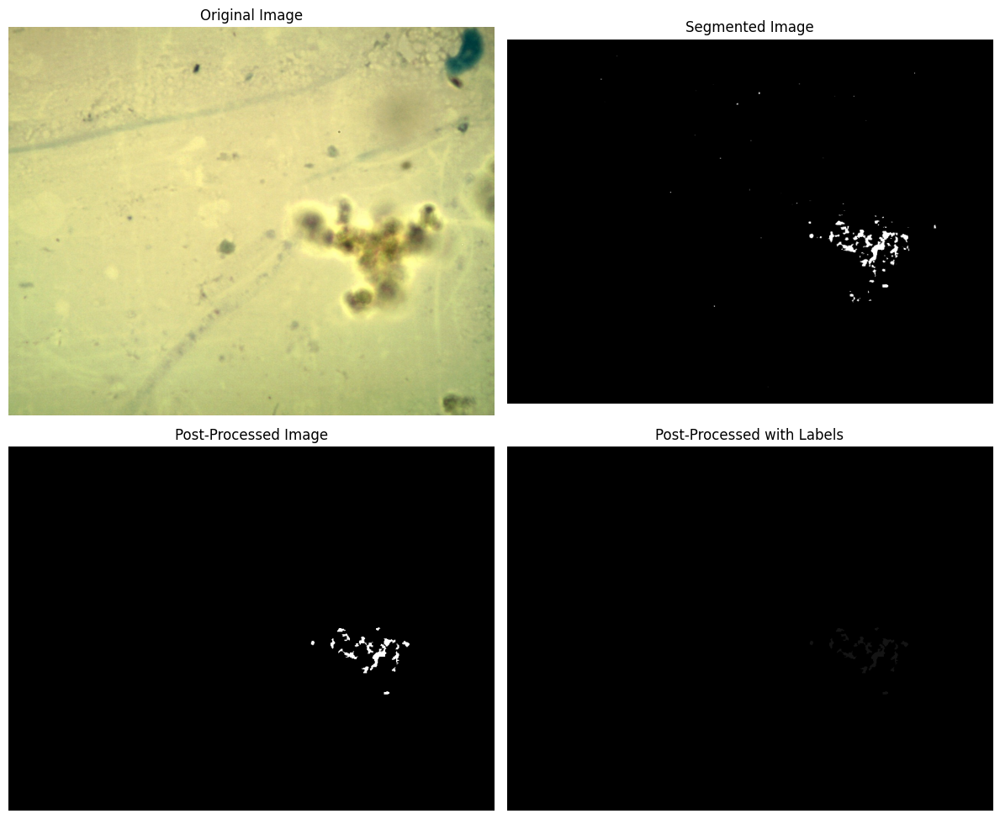

img_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)
img_pp_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)


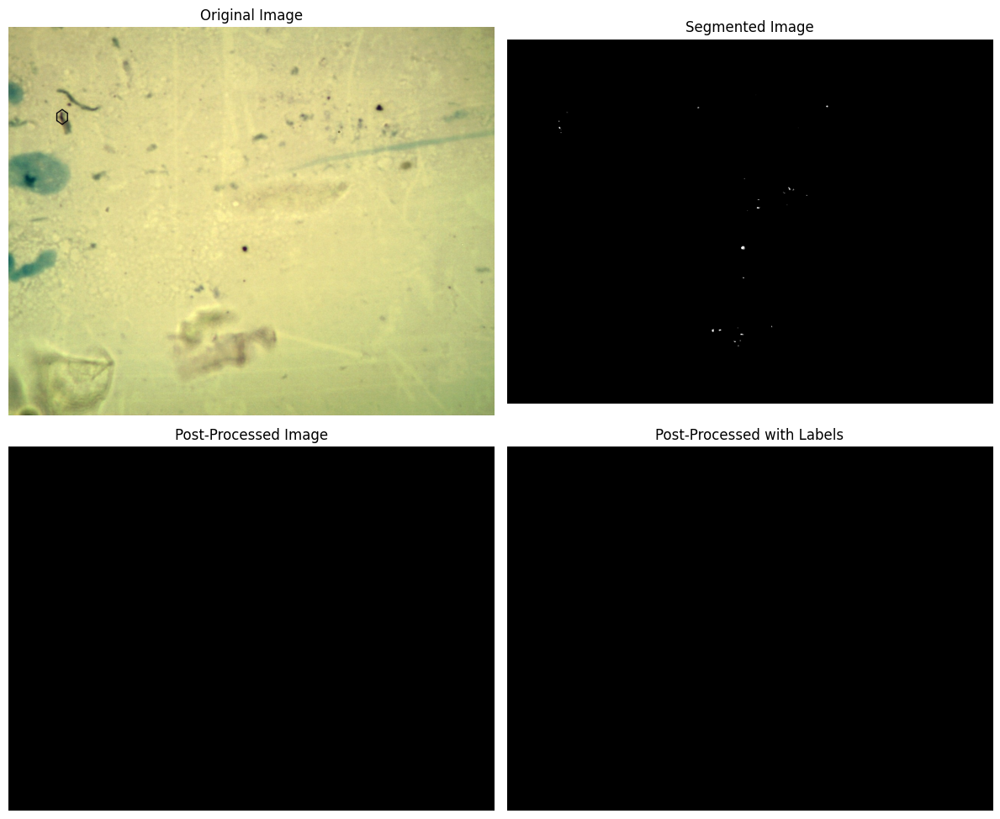

img_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)
img_pp_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)


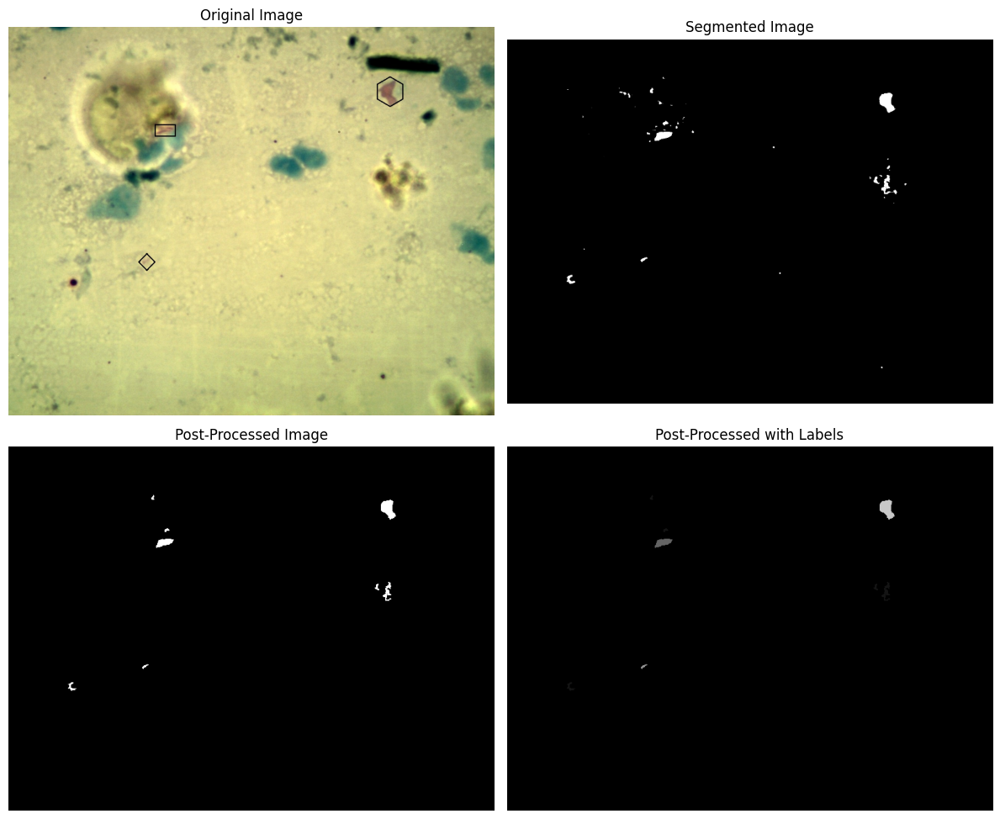

img_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)
img_pp_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)


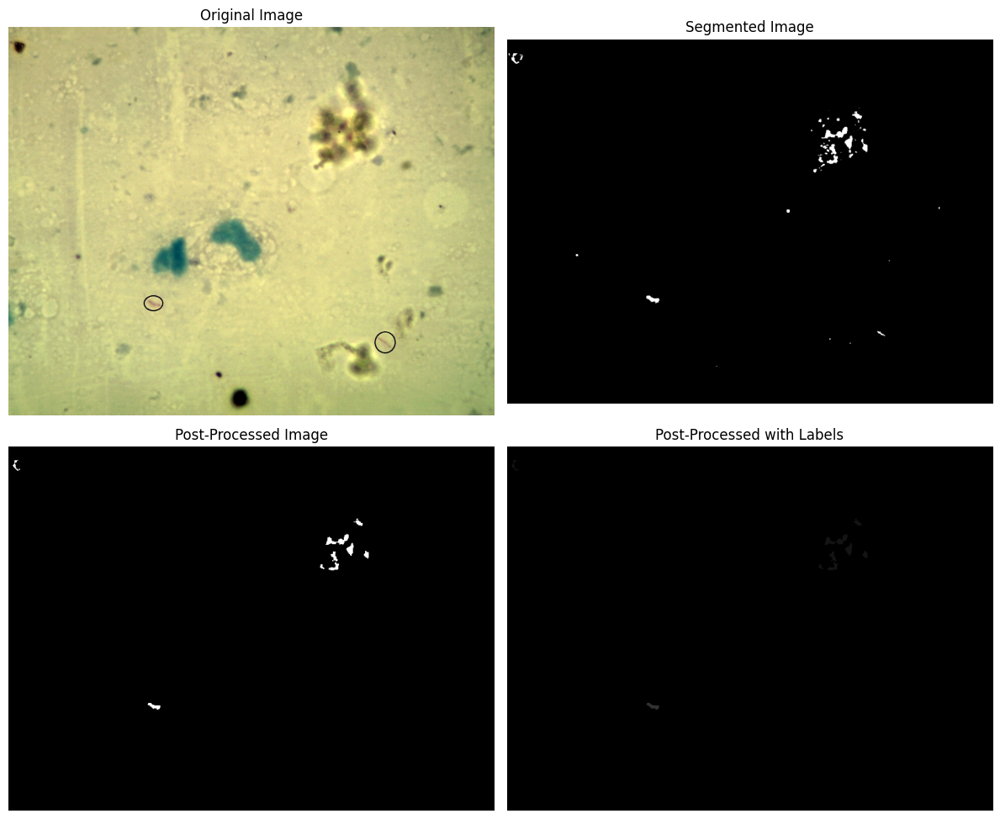

img_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)
img_pp_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)


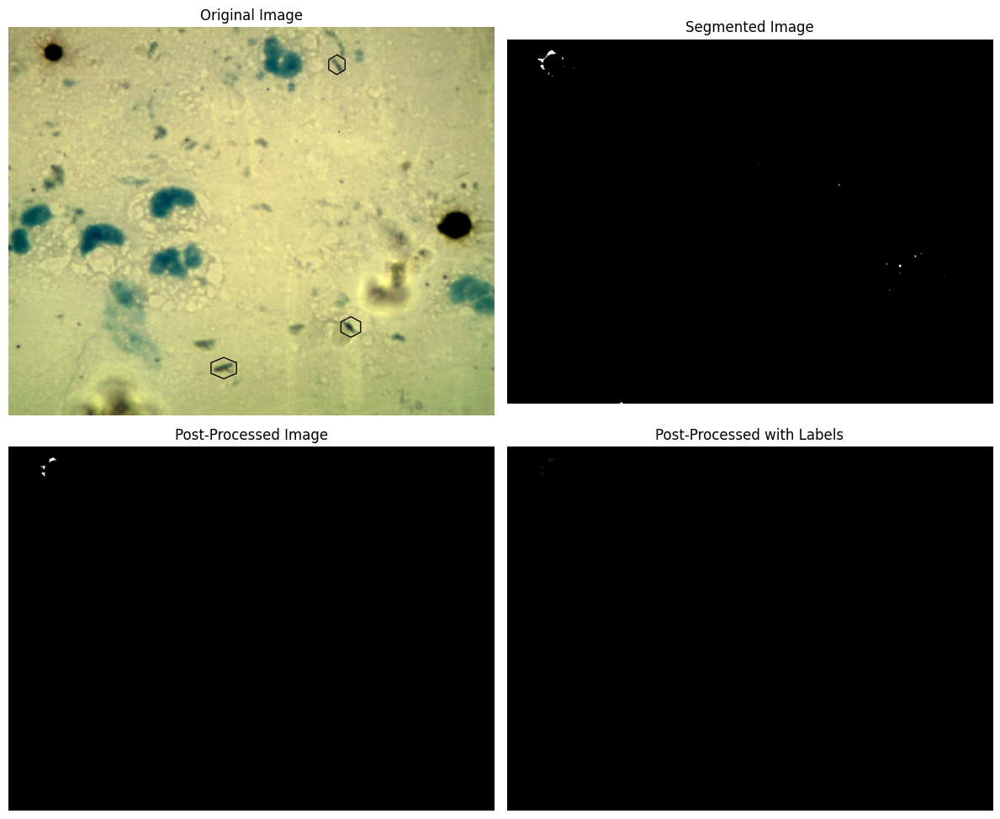

img_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)
img_pp_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)


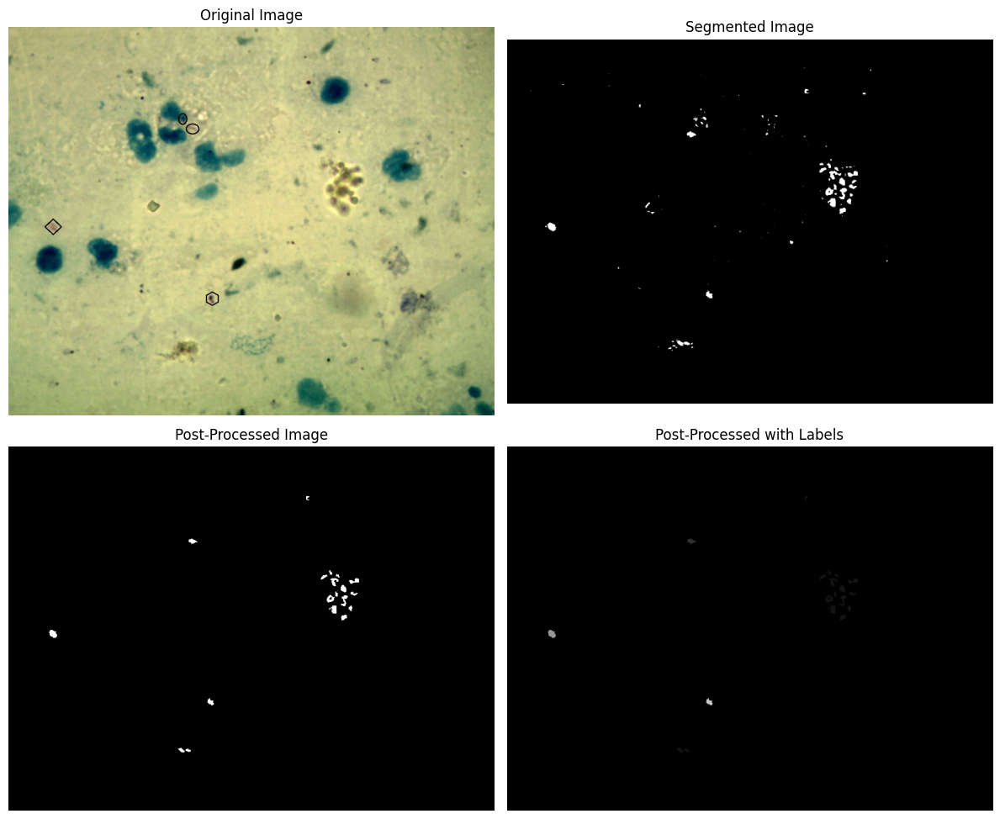

img_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)
img_pp_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)


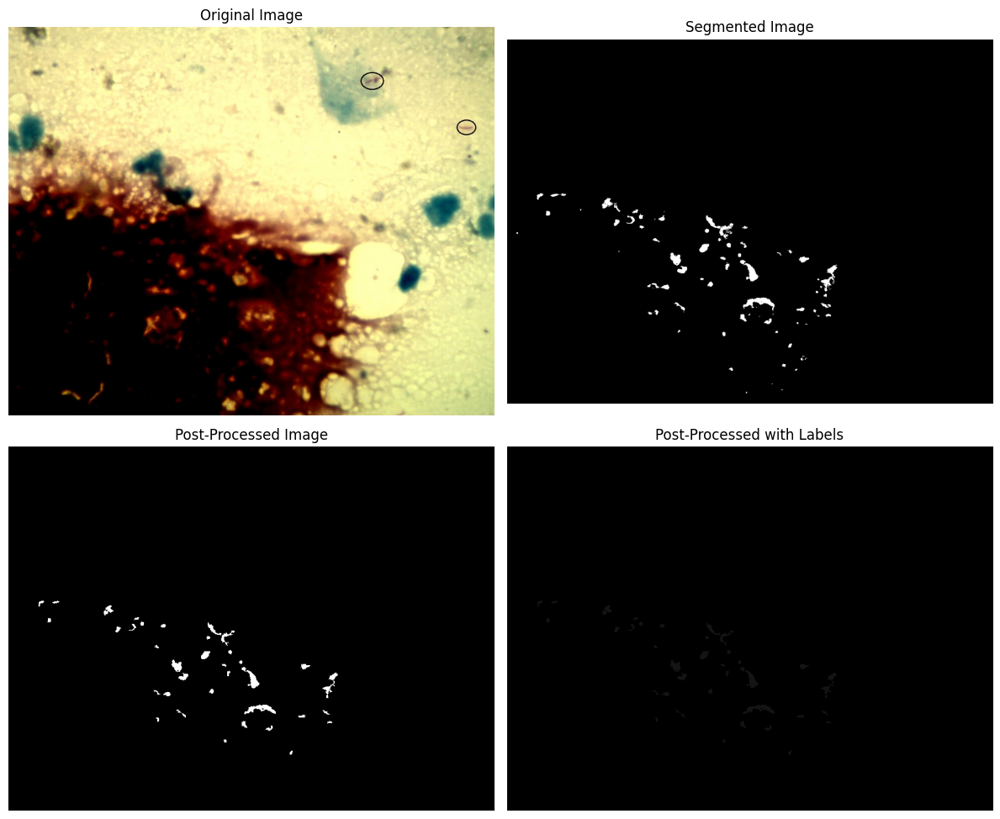

img_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)
img_pp_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)


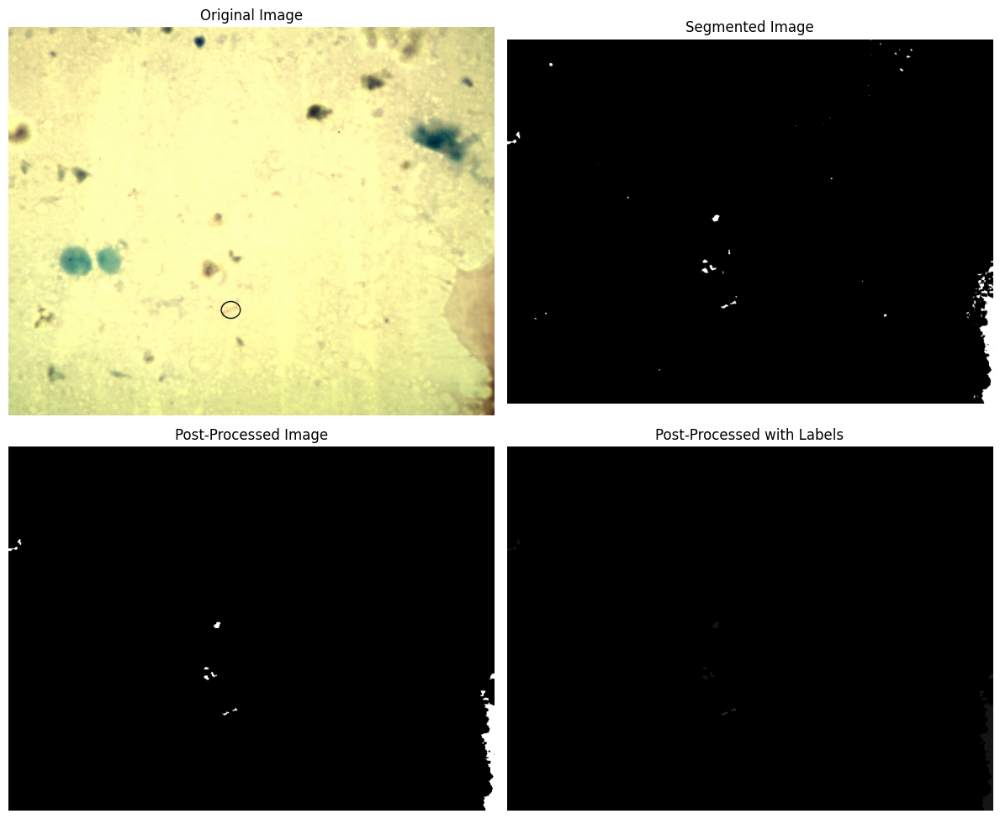

img_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)
img_pp_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)


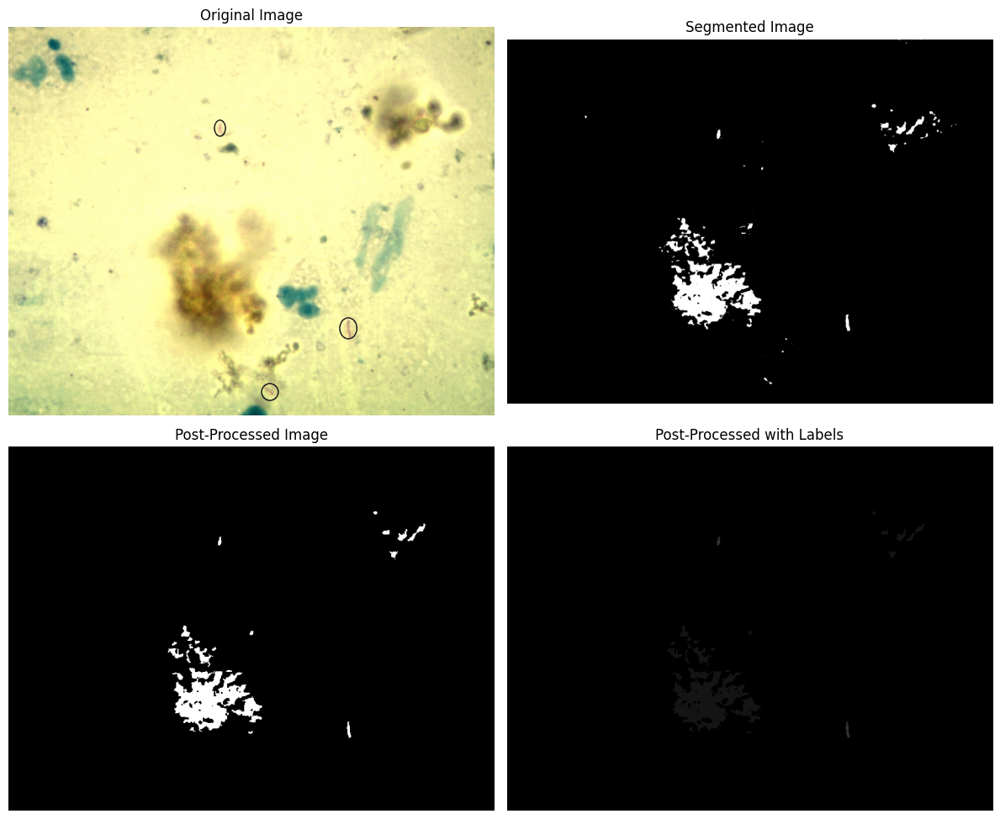

img_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)
img_pp_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)


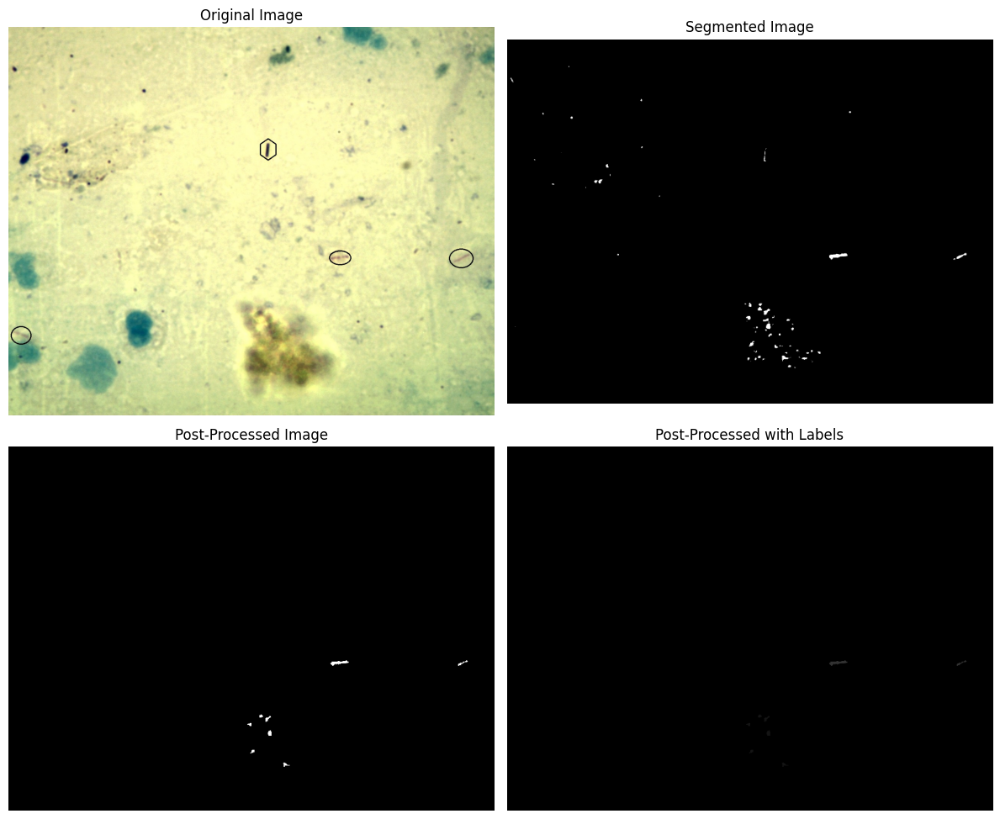

img_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)
img_pp_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)


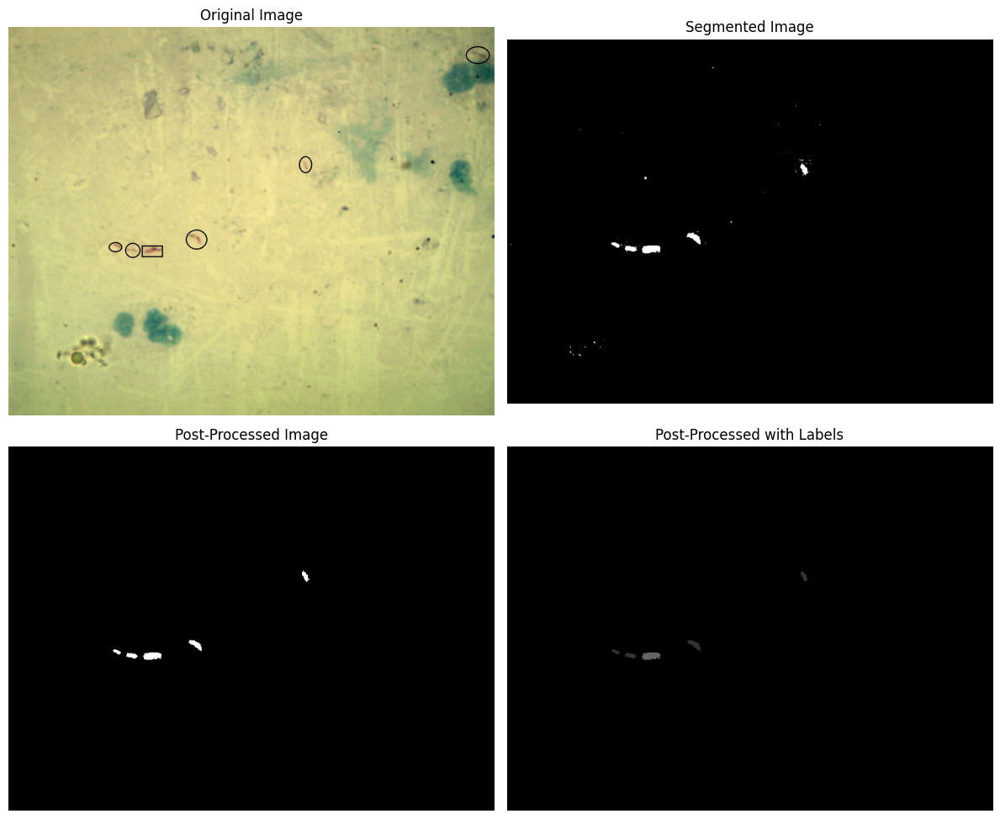

img_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)
img_pp_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)


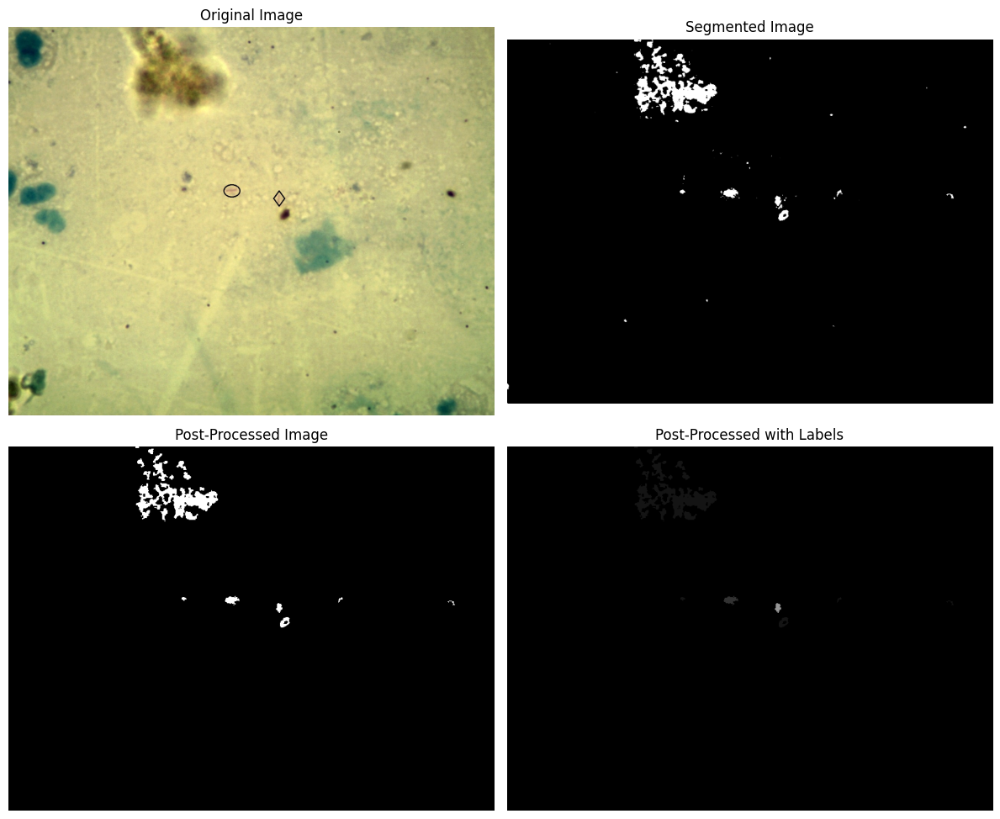

img_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)
img_pp_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)


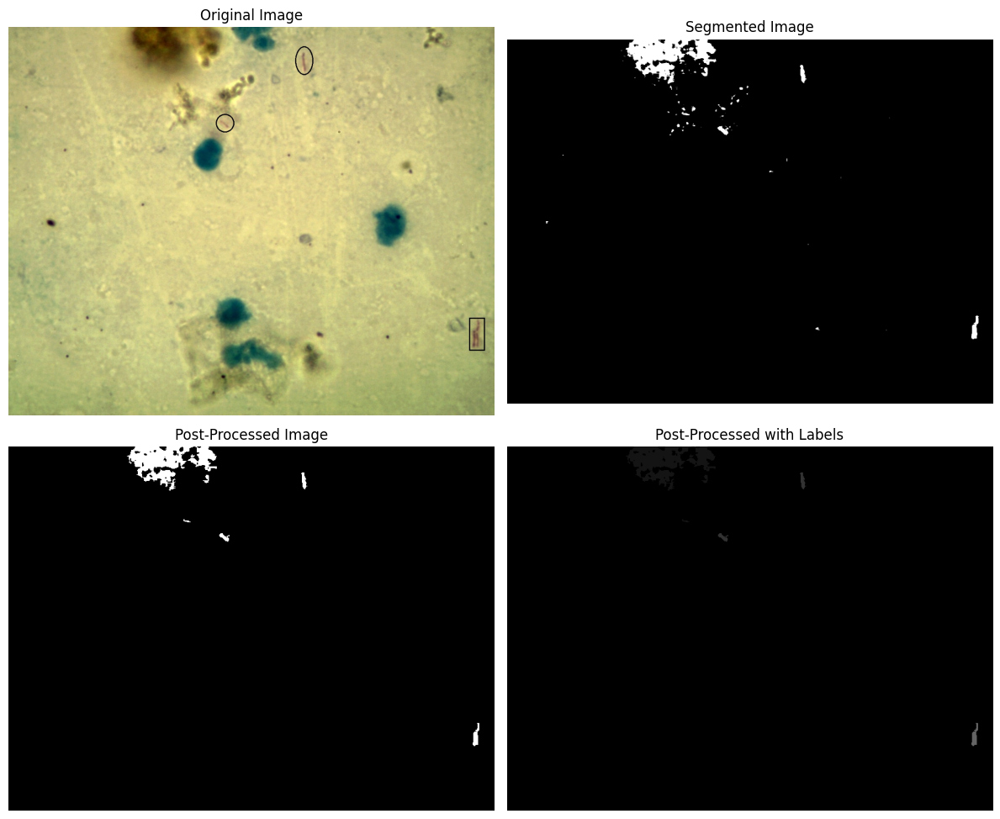

img_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)
img_pp_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)


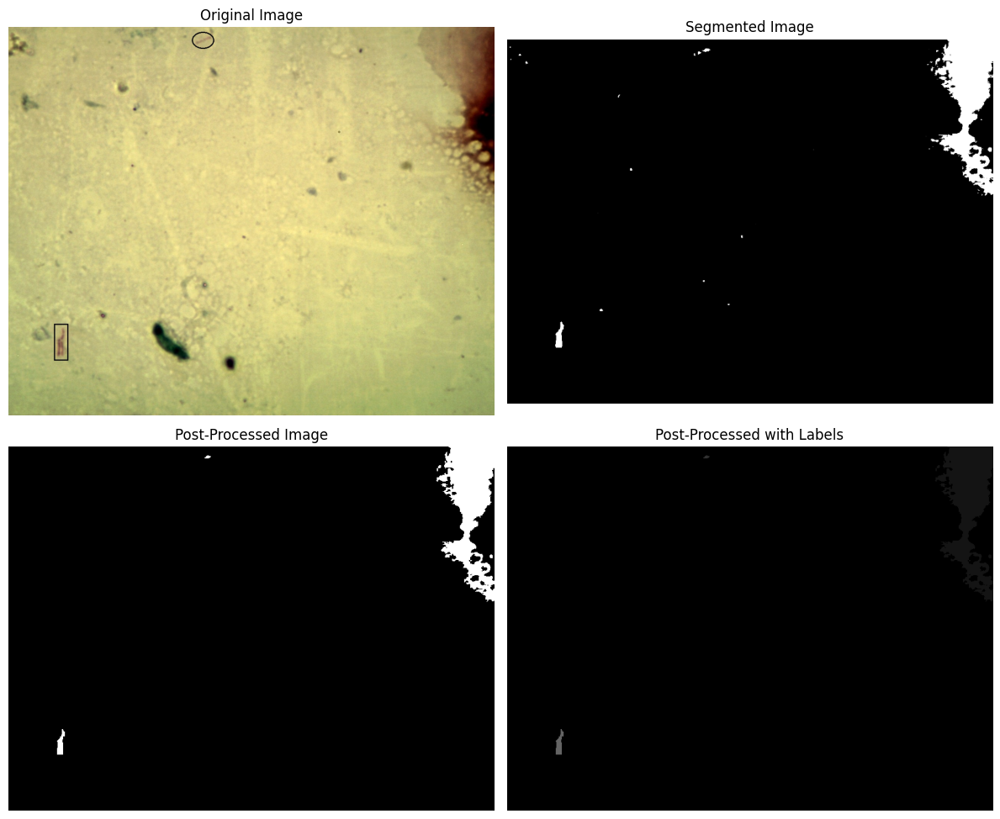

img_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)
img_pp_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)


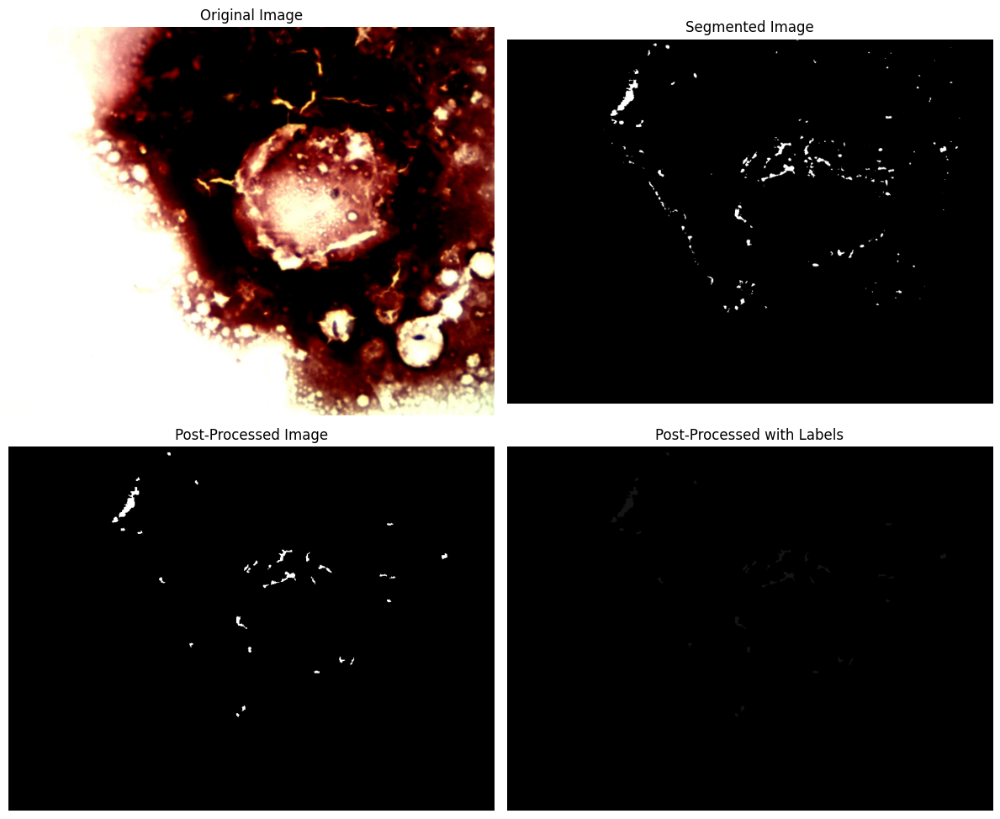

img_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)
img_pp_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)


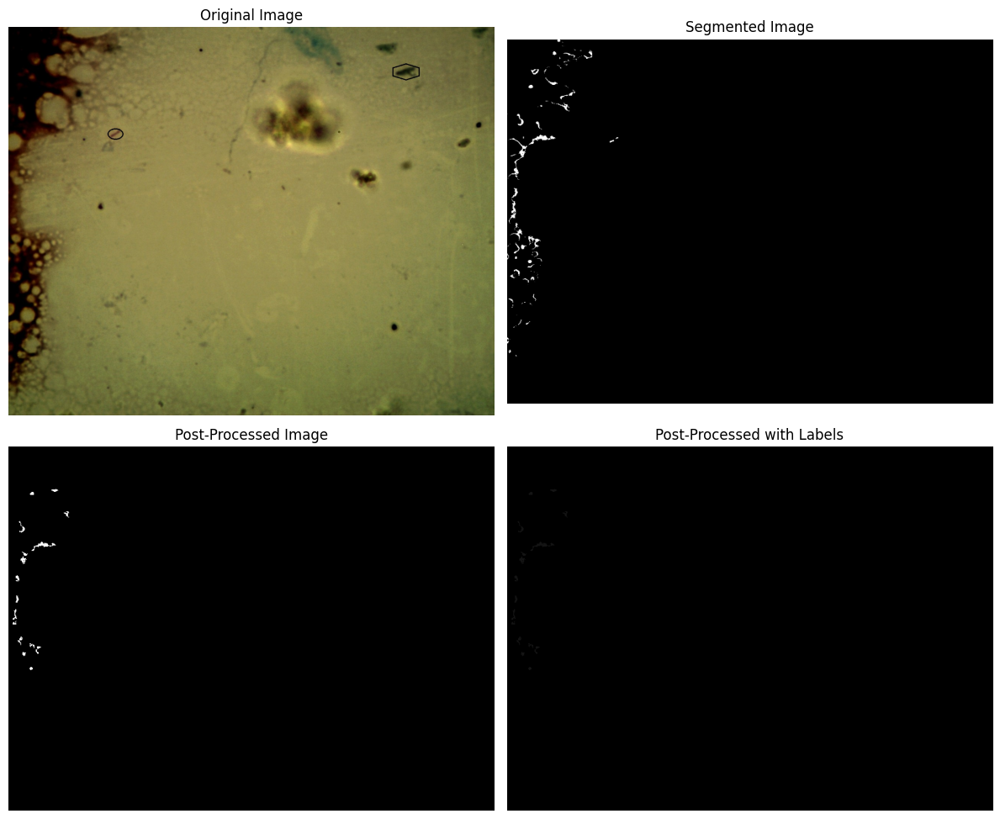

img_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)
img_pp_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)


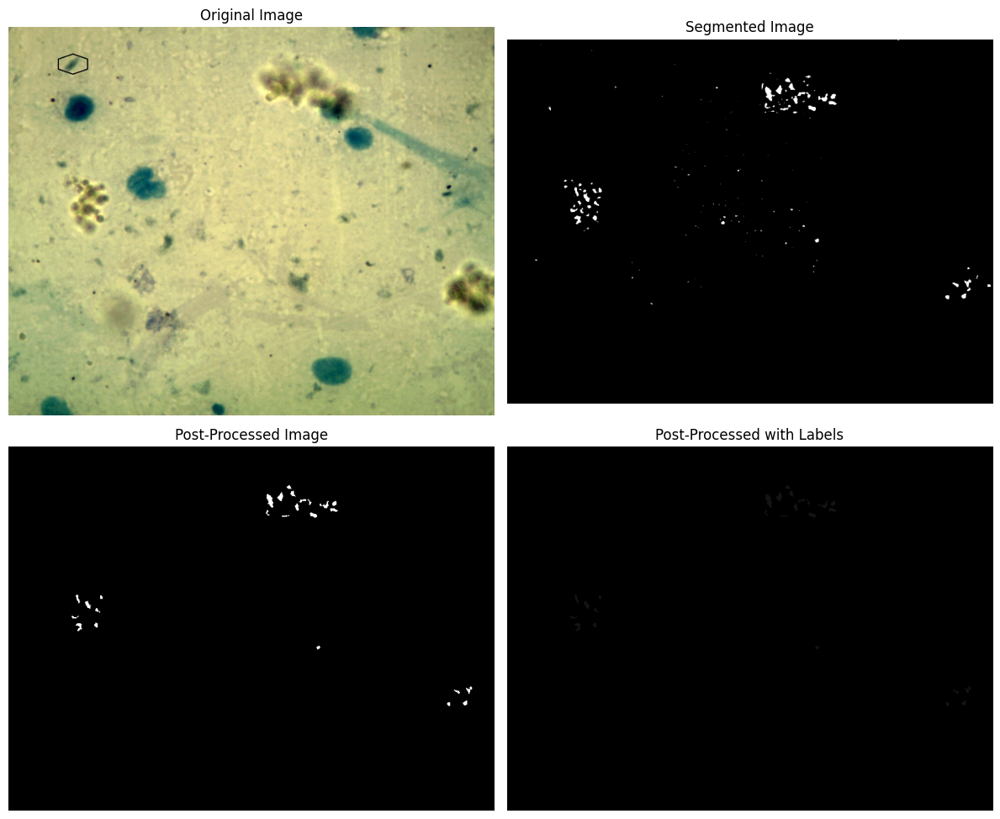

img_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)
img_pp_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)


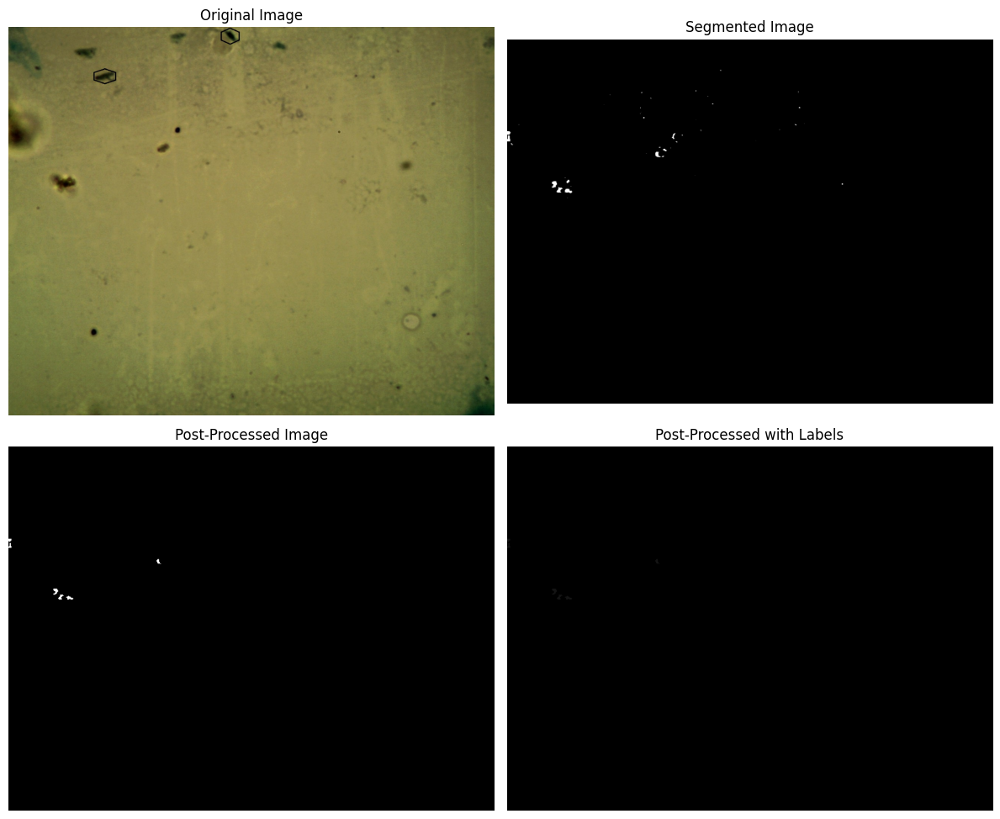

img_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)
img_pp_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)


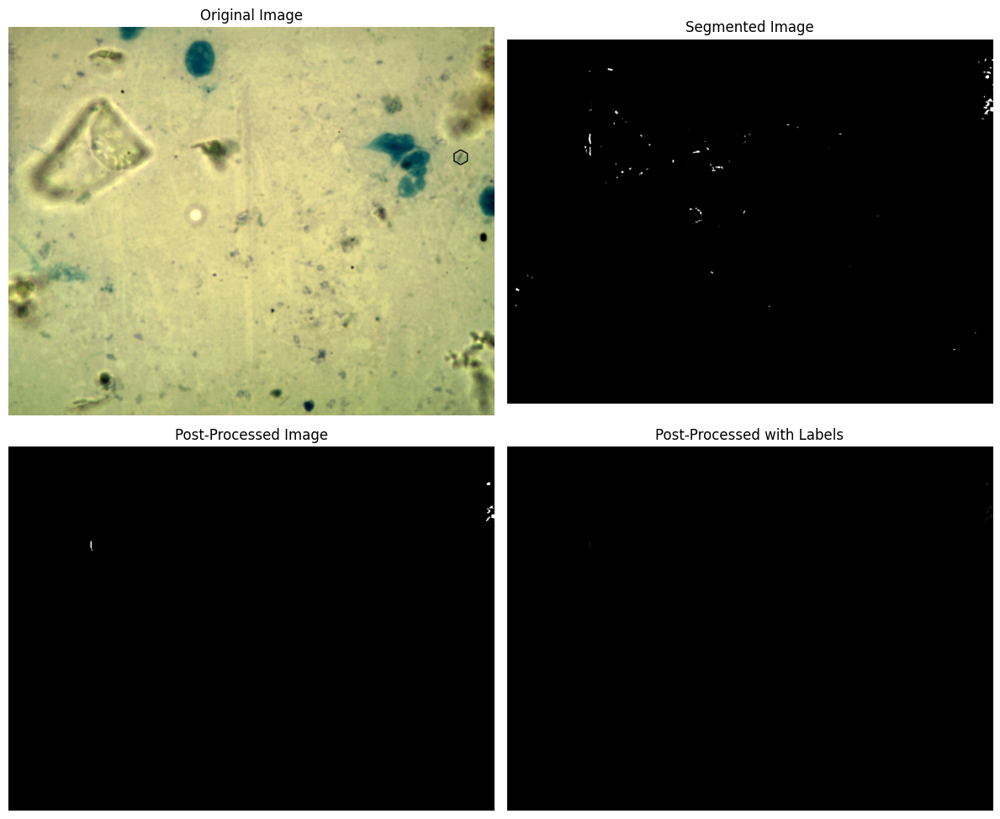

img_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)
img_pp_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)


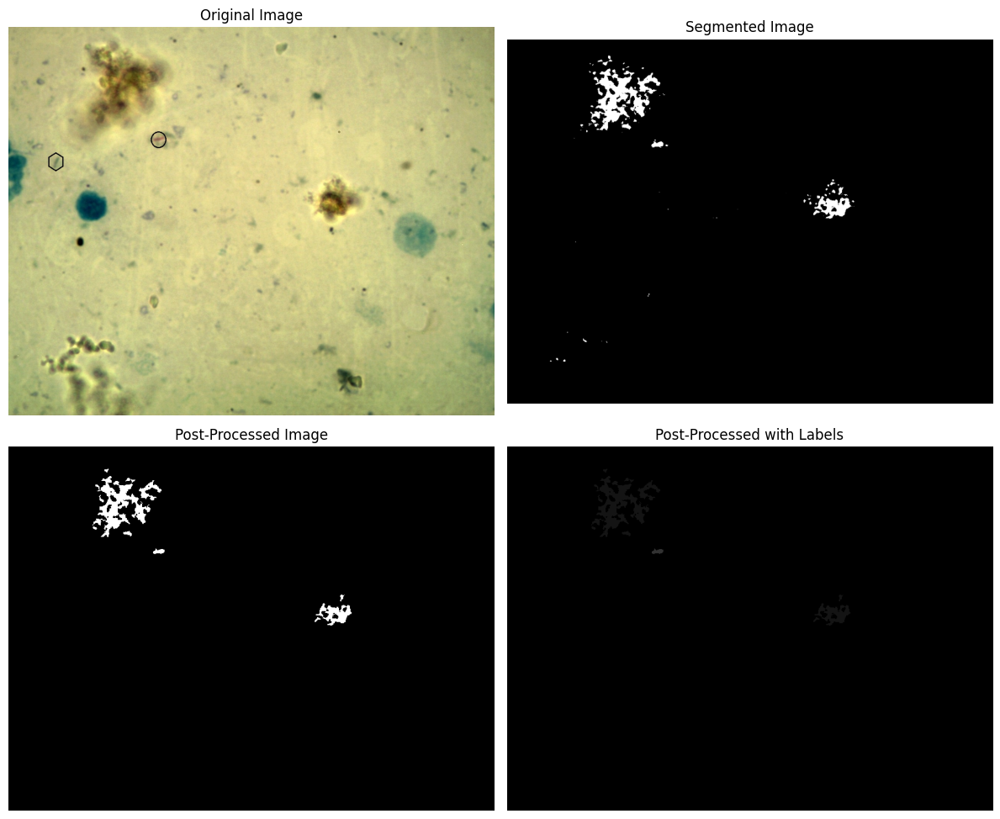

img_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)
img_pp_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)


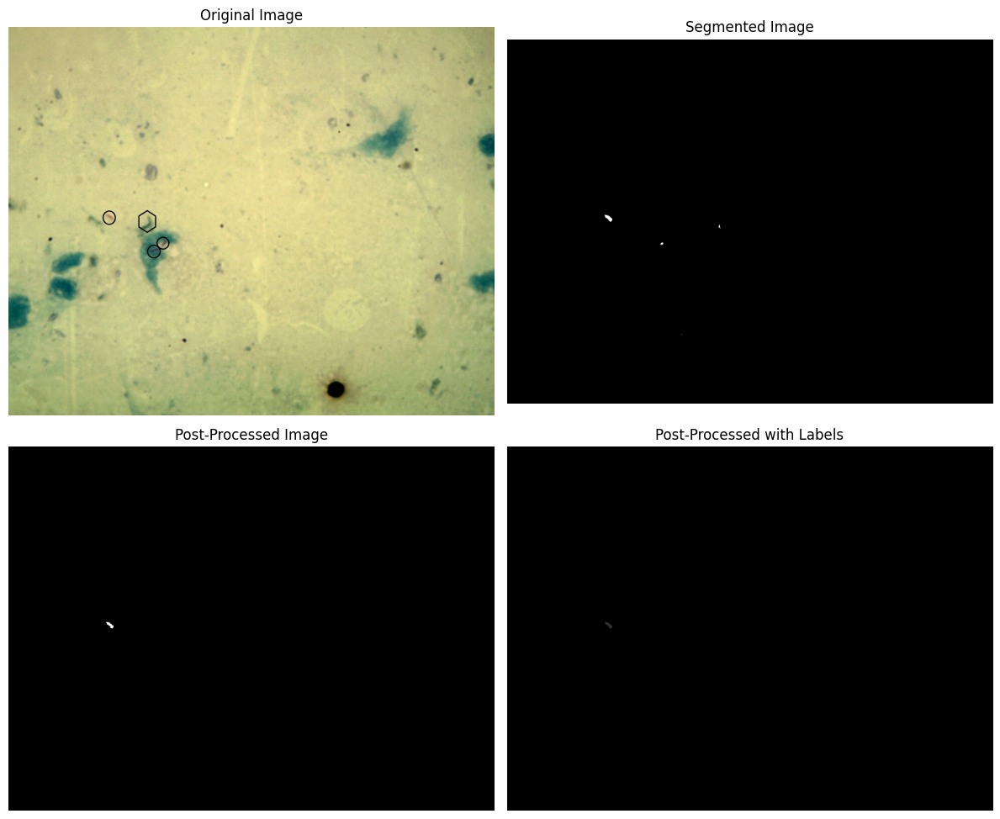

img_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)
img_pp_lbl type: <class 'numpy.ndarray'>, shape: (600, 800)


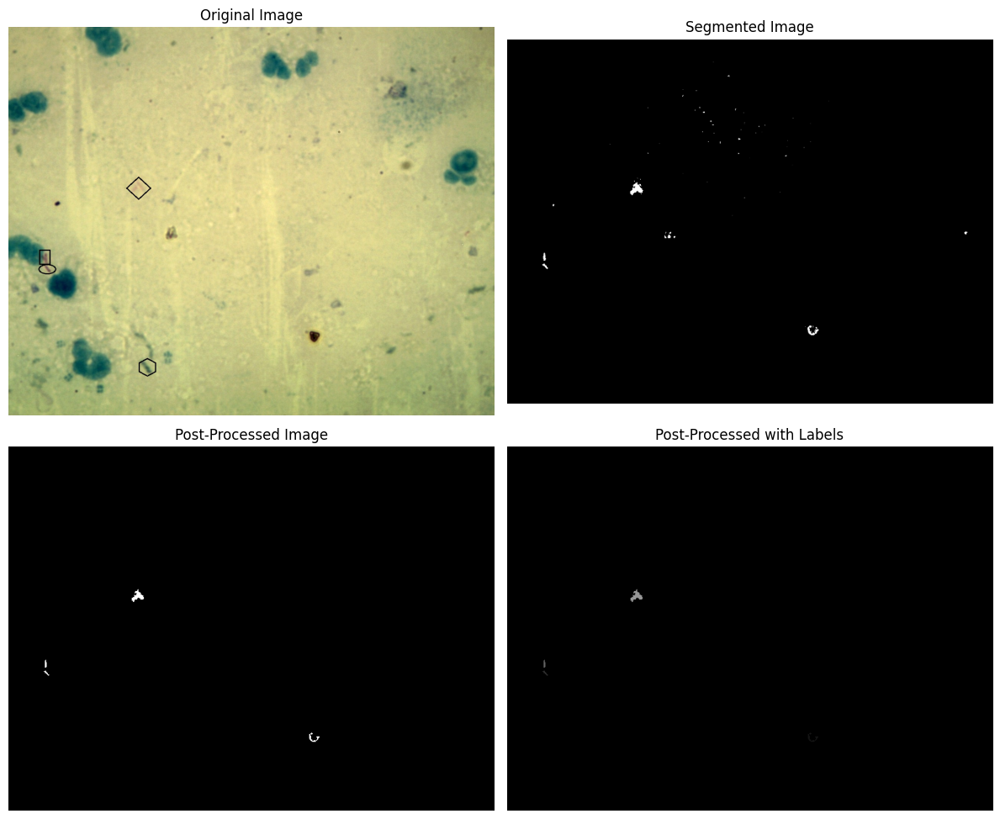

In [29]:
for img_file in img_files:
    img_file_path = os.path.join(img_fold_path, img_file)
    orig_img = cv2.imread(img_file_path)

    if orig_img is None:
        print(f"Warning: Unable to read image {img_file_path}")
        continue
    
    orig_img_shape = orig_img.shape[0:2]
    img = orig_img.copy()
    
    img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    _, img_th = cv2.threshold(img_gray, 30, 255, cv2.THRESH_BINARY_INV)
    img_th_inv = 255 - img_th
    
    img_seg = image_segmentation(img)
    img_seg = cv2.bitwise_and(img_seg, img_th_inv)
    img_seg = cv2.resize(img_seg, (img_shape[1], img_shape[0]))
    
    img_pp = image_postprocess(img_seg)
    img_lbl, img_pp_lbl = label_image_objects(img_file, annot_fold_path)
    
    # Print types and shapes of the return values
    print(f"img_lbl type: {type(img_lbl)}, shape: {img_lbl.shape}")
    print(f"img_pp_lbl type: {type(img_pp_lbl)}, shape: {img_pp_lbl.shape}")

    # Visualize the images
    visualize_images(orig_img, img_seg, img_pp, img_pp_lbl)


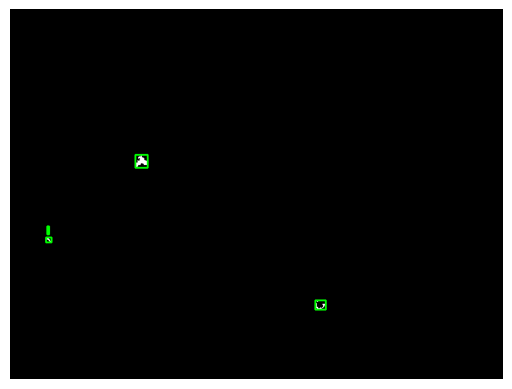

In [59]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def detect_and_draw_bounding_boxes(img_pp, threshold_value=240):
    # Apply binary thresholding
    _, binary_image = cv2.threshold(img_pp, threshold_value, 255, cv2.THRESH_BINARY)

    # Find contours
    contours, _ = cv2.findContours(binary_image, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Convert grayscale to BGR for drawing
    color_image = cv2.cvtColor(img_pp, cv2.COLOR_GRAY2BGR)
    
    # Draw bounding boxes
    for contour in contours:
        x, y, w, h = cv2.boundingRect(contour)
        cv2.rectangle(color_image, (x, y), (x+w, y+h), (0, 255, 0), 2)  # Green bounding box

    # Display the image
    plt.imshow(cv2.cvtColor(color_image, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.show()

# Assuming img_pp is the preprocessed grayscale image from previous code
# Example usage:
detect_and_draw_bounding_boxes(img_pp)


In [63]:
import cv2
import numpy as np
import csv
import os

def detect_and_store_bounding_boxes(img_pp, image_name, csv_file_path, threshold_value=240):
    # Apply binary thresholding
    _, binary_image = cv2.threshold(img_pp, threshold_value, 255, cv2.THRESH_BINARY)

    # Find contours
    contours, _ = cv2.findContours(binary_image, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Get image dimensions
    image_height, image_width = img_pp.shape

    # Prepare CSV data
    csv_data = []

    # Process each contour
    for contour in contours:
        x, y, w, h = cv2.boundingRect(contour)
        csv_data.append([
            y,  # y_st_pt
            x,  # x_st_pt
            w,  # box_width
            h,  # box_height
            image_name,  # Image_name
            image_width,  # Image_width
            image_height  # Image_height
        ])
    
    # Write data to CSV
    with open(csv_file_path, mode='w', newline='') as file:
        writer = csv.writer(file)
        writer.writerow(['y_st_pt', 'x_st_pt', 'box_width', 'box_height', 'Image_name', 'Image_width', 'Image_height'])
        writer.writerows(csv_data)

# Example usage
image_path = 'C:/Users/JEEVANANTHAM/Downloads/bacilli_count/code/baci-count/data/train-test/Mannual_Microscope-2_set1/Images/1.jpg'
image_name = os.path.basename(image_path)
csv_file_path = f'C:/Users/JEEVANANTHAM/Downloads/bacilli_count/code/baci-count/data/train-test/Mannual_Microscope-2_set1/autoAnnotate/1_bounding_boxes.csv'

# Load image
img = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)  # Ensure it is in grayscale
img_pp = cv2.GaussianBlur(img, (5, 5), 0)  # Apply preprocessing if needed

# Detect and store bounding boxes
detect_and_store_bounding_boxes(img_pp, image_name, csv_file_path)


In [ ]:
import cv2
import pandas as pd
import os

def detect_and_save_bounding_boxes(image, image_name, output_dir):
    # Convert image to grayscale (if not already)
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    
    # Threshold the image to get binary image of white objects
    _, binary = cv2.threshold(gray, 200, 255, cv2.THRESH_BINARY)
    
    # Find contours
    contours, _ = cv2.findContours(binary, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    # Prepare data for CSV
    data = []
    image_height, image_width = image.shape[:2]
    
    for contour in contours:
        x, y, w, h = cv2.boundingRect(contour)
        data.append({
            'x_st_pt': x,
            'y_st_pt': y,
            'box_width': w,
            'box_height': h,
            'Image_name': image_name,
            'Image_width': image_width,
            'Image_height': image_height
        })
    
    # Create DataFrame
    df = pd.DataFrame(data)
    
    # Save to CSV
    csv_path = os.path.join(output_dir, f"{os.path.splitext(image_name)[0]}.csv")
    df.to_csv(csv_path, index=False)
    print(f"Saved bounding box information to {csv_path}")

In [ ]:
import cv2
import os

img_shape = (600, 800)
main_fold = 'path/to/main/folder'
folders = ['folder1', 'folder2']  # Update with actual folder names
output_dir = 'data/train-test/Mannual_Microscope-2_set1/autoAnnotate'

if not os.path.exists(output_dir):
    os.makedirs(output_dir)

for folder in folders:
    fold_path = os.path.join(main_fold, folder)
    img_fold_path = os.path.join(fold_path, "Images")
    img_files = os.listdir(img_fold_path)

    for img_file in img_files:
        img_file_path = os.path.join(img_fold_path, img_file)
        orig_img = cv2.imread(img_file_path)

        if orig_img is None:
            print(f"Warning: Unable to read image {img_file_path}")
            continue

        img_gray = cv2.cvtColor(orig_img, cv2.COLOR_BGR2GRAY)
        _, img_th = cv2.threshold(img_gray, 30, 255, cv2.THRESH_BINARY_INV)
        img_th_inv = 255 - img_th

        img_seg = image_segmentation(orig_img)
        img_seg = cv2.bitwise_and(img_seg, img_th_inv)
        img_seg = cv2.resize(img_seg, (img_shape[1], img_shape[0]))

        img_pp = image_postprocess(img_seg)
        
        # Detect and save bounding boxes for the post-processed image
        detect_and_save_bounding_boxes(img_pp, img_file, output_dir)
